# CMPE 255: Preliminary Analysis, Nov 2 2021.

### By: Ryan Cummings, Adam Goldstein, Sai Srinivas Lakkakula, Ratika Bhuwalka

## PLEASE READ

This notebook was created by compiling all of our portion's into one notebook (hence this notebook). Each person's specific code can be noted under "Name's Portion" in this notebook. Each person's portion was simply pulled from their branch on our GitHub repo and compiled all into one here. Over the course of this project everyone was committing to their *personal* branch. In the end we merged them together to create this. Enjoy.

### Ryan's Portion

### Libraries:

In [59]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import plotly.express as px
import seaborn as sns
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
import sklearn.model_selection
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import uniform
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import math

# Loading in the Data

In [2]:
data = pd.read_csv("AviationData.txt", sep="|")
#data.to_csv("255Airplane.csv")

In [3]:
data.head()

,Event Id,Investigation Type,Accident Number,Event Date,Location,Country,Latitude,Longitude,Airport Code,Airport Name,...,Air Carrier,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Weather Condition,Broad Phase of Flight,Report Status,Publication Date,
0,20131208X92103,Accident,ERA14FA068,12/08/2013,"Jacksonville, FL",United States,30.319723,-81.514167,CRG,Jacksonville Executive Airport,...,,3,,,,IMC,,Preliminary,12/13/2013,
1,20131206X95526,Accident,ERA14FA066,12/06/2013,"Sebring, FL",United States,27.463333,-81.366667,SEF,Sebring Regional Airport,...,,1,,,,,,Preliminary,12/13/2013,
2,20131205X60841,Accident,ANC14CA010,12/04/2013,"Soldotna, AK",United States,,,,,...,,,,,,,,Preliminary,,
3,20131204X65412,Accident,ERA14CA062,12/03/2013,"Hendersonville, NC",United States,,,,,...,,,,,,,,Preliminary,,
4,20131202X34203,Accident,ERA14LA059,12/02/2013,"Trenton, SC",United States,33.736944,-81.818611,6J6,Edgefield County Airport,...,,,,1,,,,Preliminary,12/13/2013,


In [4]:
data.columns

Index(['Event Id ', ' Investigation Type ', ' Accident Number ',
       ' Event Date ', ' Location ', ' Country ', ' Latitude ', ' Longitude ',
       ' Airport Code ', ' Airport Name ', ' Injury Severity ',
       ' Aircraft Damage ', ' Aircraft Category ', ' Registration Number ',
       ' Make ', ' Model ', ' Amateur Built ', ' Number of Engines ',
       ' Engine Type ', ' FAR Description ', ' Schedule ',
       ' Purpose of Flight ', ' Air Carrier ', ' Total Fatal Injuries ',
       ' Total Serious Injuries ', ' Total Minor Injuries ',
       ' Total Uninjured ', ' Weather Condition ', ' Broad Phase of Flight ',
       ' Report Status ', ' Publication Date ', ' '],
      dtype='object')

### Right off the bat we can take a look at the columns and infer on which columns can be dropped for being unnecessary. From looking at the data some columns that we can drop are: Event ID, Accident Number, Registration Number, FAR Description, and Report Status. 

In [5]:
data.drop(['Event Id ', ' Accident Number ', ' Registration Number ', ' FAR Description ', ' Report Status '], inplace = True, axis=1)

In [6]:
data.head()

,Investigation Type,Event Date,Location,Country,Latitude,Longitude,Airport Code,Airport Name,Injury Severity,Aircraft Damage,...,Purpose of Flight,Air Carrier,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Weather Condition,Broad Phase of Flight,Publication Date,
0,Accident,12/08/2013,"Jacksonville, FL",United States,30.319723,-81.514167,CRG,Jacksonville Executive Airport,Fatal(3),Substantial,...,Personal,,3,,,,IMC,,12/13/2013,
1,Accident,12/06/2013,"Sebring, FL",United States,27.463333,-81.366667,SEF,Sebring Regional Airport,Fatal(1),Destroyed,...,Positioning,,1,,,,,,12/13/2013,
2,Accident,12/04/2013,"Soldotna, AK",United States,,,,,,,...,,,,,,,,,,
3,Accident,12/03/2013,"Hendersonville, NC",United States,,,,,,,...,,,,,,,,,,
4,Accident,12/02/2013,"Trenton, SC",United States,33.736944,-81.818611,6J6,Edgefield County Airport,Non-Fatal,Substantial,...,Personal,,,,1,,,,12/13/2013,


### Reasoning for Dropping:
### - Event Id -> Dropping because it was a unique identifier for the instance (accident/incident).  This would not be helpful for any type of analysis 
### - Accident Number -> Similar to above, I removed it because it was a unique identifier for the accident and it would not be helpful for analysis. 
### - Registration Number -> This was the registration number associated with the aircraft. Again, not useful since it is a unique identifier.
### - FAR Description -> This is the authority the aircraft was operating under at the time of the accident. This is something that we can look at a later time, but for now we don't need it for our analysis.
### Report Status -> This is the furthest level to which a report has been completed. Which is not helpful in our analysis.

##### More info on the columns and their descriptions can be seen at: https://www.ntsb.gov/_layouts/15/ntsb.aviation/AviationDownloadDataDictionary.aspx

# Data Cleaning

Just from the quick previews up above we can see that there is alot of missing values. I want to see how these values are being represented, is it an empty string? NaN? I explore this further below:

In [7]:
data[' Air Carrier '].values

array(['  ', '  ', '  ', ..., '  ', '  ', '  '], dtype=object)

As we can see the missing values are represented with two spaces ('  '). Now I am going to go through the df and replace all the double spaces with NaN.

In [8]:
data.replace("  ", np.NaN, inplace = True)
data.head()

,Investigation Type,Event Date,Location,Country,Latitude,Longitude,Airport Code,Airport Name,Injury Severity,Aircraft Damage,...,Purpose of Flight,Air Carrier,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Weather Condition,Broad Phase of Flight,Publication Date,
0,Accident,12/08/2013,"Jacksonville, FL",United States,30.319723,-81.514167,CRG,Jacksonville Executive Airport,Fatal(3),Substantial,...,Personal,NaN,3,NaN,NaN,NaN,IMC,NaN,12/13/2013,
1,Accident,12/06/2013,"Sebring, FL",United States,27.463333,-81.366667,SEF,Sebring Regional Airport,Fatal(1),Destroyed,...,Positioning,NaN,1,NaN,NaN,NaN,NaN,NaN,12/13/2013,
2,Accident,12/04/2013,"Soldotna, AK",United States,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,
3,Accident,12/03/2013,"Hendersonville, NC",United States,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,
4,Accident,12/02/2013,"Trenton, SC",United States,33.736944,-81.818611,6J6,Edgefield County Airport,Non-Fatal,Substantial,...,Personal,NaN,NaN,NaN,1,NaN,NaN,NaN,12/13/2013,


# Additional Cleaning

Here I wanted to adjust the columns names since they have an extra space at the beginning and at the end. To do that I will strip the whitespace from the column names:

In [9]:
data = data.apply(lambda x: x.str.strip() if x.dtype == "object" else x).rename(columns=lambda x: x.strip())
data.columns

Index(['Investigation Type', 'Event Date', 'Location', 'Country', 'Latitude',
       'Longitude', 'Airport Code', 'Airport Name', 'Injury Severity',
       'Aircraft Damage', 'Aircraft Category', 'Make', 'Model',
       'Amateur Built', 'Number of Engines', 'Engine Type', 'Schedule',
       'Purpose of Flight', 'Air Carrier', 'Total Fatal Injuries',
       'Total Serious Injuries', 'Total Minor Injuries', 'Total Uninjured',
       'Weather Condition', 'Broad Phase of Flight', 'Publication Date', ''],
      dtype='object')

Also, I filled the double spaces ("  ") with NA in the section above this but the NA values in the columns: Total Fatal Injuries, Total Serious Injuries, Total Minor Injuries, and Total Uninjured can be represented by 0. Therefore I can fill NA with zero which is seen below.

In [10]:
# fill na with 0 in columns related to injuries
data['Total Fatal Injuries'] = data['Total Fatal Injuries'].fillna(0).astype("int")
data['Total Serious Injuries'] = data['Total Serious Injuries'].fillna(0).astype("int")
data['Total Minor Injuries'] = data['Total Minor Injuries'].fillna(0).astype("int")
data['Total Uninjured'] = data['Total Uninjured'].fillna(0).astype("int")

In [11]:
data

,Investigation Type,Event Date,Location,Country,Latitude,Longitude,Airport Code,Airport Name,Injury Severity,Aircraft Damage,...,Purpose of Flight,Air Carrier,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Weather Condition,Broad Phase of Flight,Publication Date,
0,Accident,12/08/2013,"Jacksonville, FL",United States,30.319723,-81.514167,CRG,Jacksonville Executive Airport,Fatal(3),Substantial,...,Personal,NaN,3,0,0,0,IMC,NaN,12/13/2013,
1,Accident,12/06/2013,"Sebring, FL",United States,27.463333,-81.366667,SEF,Sebring Regional Airport,Fatal(1),Destroyed,...,Positioning,NaN,1,0,0,0,NaN,NaN,12/13/2013,
2,Accident,12/04/2013,"Soldotna, AK",United States,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,0,0,0,0,NaN,NaN,NaN,
3,Accident,12/03/2013,"Hendersonville, NC",United States,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,0,0,0,0,NaN,NaN,NaN,
4,Accident,12/02/2013,"Trenton, SC",United States,33.736944,-81.818611,6J6,Edgefield County Airport,Non-Fatal,Substantial,...,Personal,NaN,0,0,1,0,NaN,NaN,12/13/2013,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
74423,Accident,08/30/1974,"Saltville, VA",United States,36.922223,-81.878056,NaN,NaN,Fatal(3),Destroyed,...,Personal,NaN,3,0,0,0,IMC,CRUISE,02/26/2007,
74424,Accident,07/19/1962,"BRIDGEPORT, CA",United States,NaN,NaN,NaN,NaN,Fatal(4),Destroyed,...,Personal,NaN,4,0,0,0,UNK,UNKNOWN,09/19/1996,
74425,Accident,10/24/1948,"MOOSE CREEK, ID",United States,NaN,NaN,NaN,NaN,Fatal(2),Destroyed,...,Personal,NaN,2,0,0,0,UNK,CRUISE,NaN,
74426,Accident,NaN,"Unknown, UN",United States,NaN,NaN,NaN,NaN,Non-Fatal,Substantial,...,PUBF,NaN,0,0,0,1,NaN,NaN,02/08/2013,


I also want to add a binary column "is_fatal" which can be used with a Machine Learning Classification algorithm:

In [12]:
# fatal or not (binary 1 or 0)
data['is_fatal'] = data['Total Fatal Injuries'].map(lambda x: 1 if x > 0 else 0)

In [13]:
data

,Investigation Type,Event Date,Location,Country,Latitude,Longitude,Airport Code,Airport Name,Injury Severity,Aircraft Damage,...,Air Carrier,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Weather Condition,Broad Phase of Flight,Publication Date,,is_fatal
0,Accident,12/08/2013,"Jacksonville, FL",United States,30.319723,-81.514167,CRG,Jacksonville Executive Airport,Fatal(3),Substantial,...,NaN,3,0,0,0,IMC,NaN,12/13/2013,,1
1,Accident,12/06/2013,"Sebring, FL",United States,27.463333,-81.366667,SEF,Sebring Regional Airport,Fatal(1),Destroyed,...,NaN,1,0,0,0,NaN,NaN,12/13/2013,,1
2,Accident,12/04/2013,"Soldotna, AK",United States,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,0,0,0,0,NaN,NaN,NaN,,0
3,Accident,12/03/2013,"Hendersonville, NC",United States,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,0,0,0,0,NaN,NaN,NaN,,0
4,Accident,12/02/2013,"Trenton, SC",United States,33.736944,-81.818611,6J6,Edgefield County Airport,Non-Fatal,Substantial,...,NaN,0,0,1,0,NaN,NaN,12/13/2013,,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
74423,Accident,08/30/1974,"Saltville, VA",United States,36.922223,-81.878056,NaN,NaN,Fatal(3),Destroyed,...,NaN,3,0,0,0,IMC,CRUISE,02/26/2007,,1
74424,Accident,07/19/1962,"BRIDGEPORT, CA",United States,NaN,NaN,NaN,NaN,Fatal(4),Destroyed,...,NaN,4,0,0,0,UNK,UNKNOWN,09/19/1996,,1
74425,Accident,10/24/1948,"MOOSE CREEK, ID",United States,NaN,NaN,NaN,NaN,Fatal(2),Destroyed,...,NaN,2,0,0,0,UNK,CRUISE,NaN,,1
74426,Accident,NaN,"Unknown, UN",United States,NaN,NaN,NaN,NaN,Non-Fatal,Substantial,...,NaN,0,0,0,1,NaN,NaN,02/08/2013,,0


For our analysis we decided to only used flights that were in the United States:

In [14]:
# filter by usa only
data = data[data['Country'] == "United States"]

In [15]:
data.head()

,Investigation Type,Event Date,Location,Country,Latitude,Longitude,Airport Code,Airport Name,Injury Severity,Aircraft Damage,...,Air Carrier,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Weather Condition,Broad Phase of Flight,Publication Date,,is_fatal
0,Accident,12/08/2013,"Jacksonville, FL",United States,30.319723,-81.514167,CRG,Jacksonville Executive Airport,Fatal(3),Substantial,...,NaN,3,0,0,0,IMC,NaN,12/13/2013,,1
1,Accident,12/06/2013,"Sebring, FL",United States,27.463333,-81.366667,SEF,Sebring Regional Airport,Fatal(1),Destroyed,...,NaN,1,0,0,0,NaN,NaN,12/13/2013,,1
2,Accident,12/04/2013,"Soldotna, AK",United States,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,0,0,0,0,NaN,NaN,NaN,,0
3,Accident,12/03/2013,"Hendersonville, NC",United States,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,0,0,0,0,NaN,NaN,NaN,,0
4,Accident,12/02/2013,"Trenton, SC",United States,33.736944,-81.818611,6J6,Edgefield County Airport,Non-Fatal,Substantial,...,NaN,0,0,1,0,NaN,NaN,12/13/2013,,0


In [16]:
data.drop([''],inplace=True, axis=1)

/Users/saisrinivaslakkakula/opt/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


# Data Preprocessing

The next thing that I want to do is get the data prepped to be used in possible algorithms such as: Regression, Decision Trees, and Clustering. Feature selection and preperation is important because key insights can be missed because of uncleaned data. For example, the first thing that I want to do is seperate the Date column into 3 columns: Month, Day, Year. I feel that this is important because we are looking at aircraft accidents and there may be more accidents during the winter time of year for example. So extracting month, in this example, is important because if we are going to build some models and this feature may be a key influencer. 

Another feature that I want to extract more info from is the column: 'Injury Severity'. This column consists of the type of injury that occured, in this case it has the values: Fatal, Non-Fatal, Incident, and Unavailable. I want to clean this column because it has values such as: Fatal(14), Fatal(7). I want to take away the number that is in the paranthesis, which is the number of fatalities, and just have it be Fatal. The number of fatalities is seen in another column which makes it redundant to have it again here.

Along with this, I want to seperate the 'Location' column. I want to seperate it because it is composed of city and state in the format of 'City,State'. Having these as seperate columns will be potentially helpful when creating a model. 

These 3 feature engineering decisions are seen below:

### Date

In [17]:
# Date
data[['Month','Day','Year']] = data['Event Date'].str.split('/',expand=True)

/Users/saisrinivaslakkakula/opt/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:3191: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


In [18]:
data[['Event Date','Month','Day','Year']].head()

,Event Date,Month,Day,Year
0,12/08/2013,12,08,2013
1,12/06/2013,12,06,2013
2,12/04/2013,12,04,2013
3,12/03/2013,12,03,2013
4,12/02/2013,12,02,2013


### Injury Severity

In [19]:
# Injury Severity
lst = []
for i in data['Injury Severity']:
    try:
        if i == np.NaN:
            lst.append(np.NaN)
            continue
        if 'Fatal(' in i:
            lst.append(i[0:-4])
        else:
            lst.append(i)
    except:
        continue

In [20]:
# Injury Severity
severity_lst = []
counter = 0
for i in (pd.isna(data['Injury Severity']) == False):
    if i == True:
        severity_lst.append(lst[counter])
        counter += 1
    if i == False:
        severity_lst.append(np.NaN)

In [ ]:
len(severity_lst)

In [21]:
data['Injury Severity'] = severity_lst
data.head()

<ipython-input-21-642f5ce067a7>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Injury Severity'] = severity_lst


,Investigation Type,Event Date,Location,Country,Latitude,Longitude,Airport Code,Airport Name,Injury Severity,Aircraft Damage,...,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Weather Condition,Broad Phase of Flight,Publication Date,is_fatal,Month,Day,Year
0,Accident,12/08/2013,"Jacksonville, FL",United States,30.319723,-81.514167,CRG,Jacksonville Executive Airport,Fata,Substantial,...,0,0,0,IMC,NaN,12/13/2013,1,12,08,2013
1,Accident,12/06/2013,"Sebring, FL",United States,27.463333,-81.366667,SEF,Sebring Regional Airport,Fata,Destroyed,...,0,0,0,NaN,NaN,12/13/2013,1,12,06,2013
2,Accident,12/04/2013,"Soldotna, AK",United States,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,NaN,NaN,NaN,0,12,04,2013
3,Accident,12/03/2013,"Hendersonville, NC",United States,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,NaN,NaN,NaN,0,12,03,2013
4,Accident,12/02/2013,"Trenton, SC",United States,33.736944,-81.818611,6J6,Edgefield County Airport,Non-Fatal,Substantial,...,0,1,0,NaN,NaN,12/13/2013,0,12,02,2013


### Location

In [22]:
# Location
data[['Location_City','Location_State']] = data['Location'].str.split(',',expand=True)[[0,1]]
data[['Location','Location_City','Location_State']].head()

/Users/saisrinivaslakkakula/opt/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:3191: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


,Location,Location_City,Location_State
0,"Jacksonville, FL",Jacksonville,FL
1,"Sebring, FL",Sebring,FL
2,"Soldotna, AK",Soldotna,AK
3,"Hendersonville, NC",Hendersonville,NC
4,"Trenton, SC",Trenton,SC


### Now that the data has been handled the way I wanted it to, we can drop the columns that have been transformed:

In [23]:
data.drop(['Location', 'Event Date'], inplace = True, axis = 1)

/Users/saisrinivaslakkakula/opt/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [24]:
data.head()

,Investigation Type,Country,Latitude,Longitude,Airport Code,Airport Name,Injury Severity,Aircraft Damage,Aircraft Category,Make,...,Total Uninjured,Weather Condition,Broad Phase of Flight,Publication Date,is_fatal,Month,Day,Year,Location_City,Location_State
0,Accident,United States,30.319723,-81.514167,CRG,Jacksonville Executive Airport,Fata,Substantial,Airplane,CESSNA,...,0,IMC,NaN,12/13/2013,1,12,08,2013,Jacksonville,FL
1,Accident,United States,27.463333,-81.366667,SEF,Sebring Regional Airport,Fata,Destroyed,Helicopter,TEXAS HELICOPTER CORP,...,0,NaN,NaN,12/13/2013,1,12,06,2013,Sebring,FL
2,Accident,United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,BELLANCA,...,0,NaN,NaN,NaN,0,12,04,2013,Soldotna,AK
3,Accident,United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ANDERSON ANDREAS,...,0,NaN,NaN,NaN,0,12,03,2013,Hendersonville,NC
4,Accident,United States,33.736944,-81.818611,6J6,Edgefield County Airport,Non-Fatal,Substantial,Airplane,MOFFITT OSCAR/ KIT PROSTAR A/C,...,0,NaN,NaN,12/13/2013,0,12,02,2013,Trenton,SC


# Exploration

### Location of Accidents

In [25]:
data['Latitude'] = data['Latitude'].astype("float64")
data['Longitude'] = data['Longitude'].astype("float64")
data.head()

<ipython-input-25-71d0c6b8172f>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Latitude'] = data['Latitude'].astype("float64")
<ipython-input-25-71d0c6b8172f>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Longitude'] = data['Longitude'].astype("float64")


,Investigation Type,Country,Latitude,Longitude,Airport Code,Airport Name,Injury Severity,Aircraft Damage,Aircraft Category,Make,...,Total Uninjured,Weather Condition,Broad Phase of Flight,Publication Date,is_fatal,Month,Day,Year,Location_City,Location_State
0,Accident,United States,30.319723,-81.514167,CRG,Jacksonville Executive Airport,Fata,Substantial,Airplane,CESSNA,...,0,IMC,NaN,12/13/2013,1,12,08,2013,Jacksonville,FL
1,Accident,United States,27.463333,-81.366667,SEF,Sebring Regional Airport,Fata,Destroyed,Helicopter,TEXAS HELICOPTER CORP,...,0,NaN,NaN,12/13/2013,1,12,06,2013,Sebring,FL
2,Accident,United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,BELLANCA,...,0,NaN,NaN,NaN,0,12,04,2013,Soldotna,AK
3,Accident,United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ANDERSON ANDREAS,...,0,NaN,NaN,NaN,0,12,03,2013,Hendersonville,NC
4,Accident,United States,33.736944,-81.818611,6J6,Edgefield County Airport,Non-Fatal,Substantial,Airplane,MOFFITT OSCAR/ KIT PROSTAR A/C,...,0,NaN,NaN,12/13/2013,0,12,02,2013,Trenton,SC


I was interested in making a visualization that will show us on a map where the crashes were located. I used the latitude and longitude to create this viz:

In [26]:
fig = px.scatter_geo(data, lat='Latitude', lon='Longitude')
fig.update_layout(title = 'World map of crashes', title_x=0.5)
fig.show()

### Plotting Number of Accidents by each Year

For our analysis we wanted to see if the number of accidents is decreasing over time. So I plotted the total number of accidents per year:

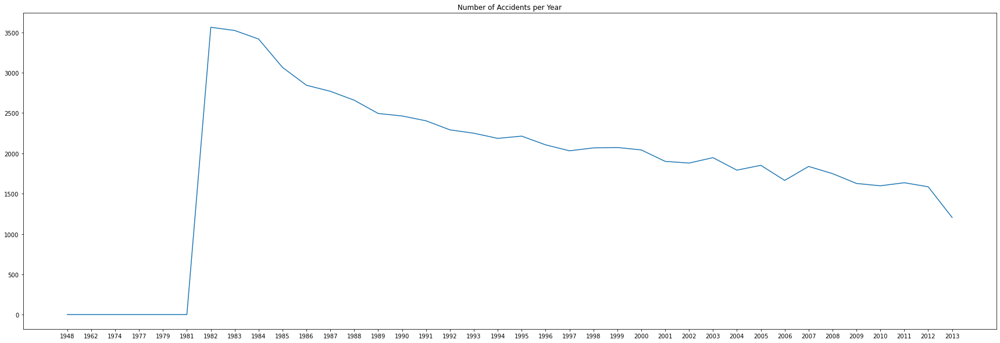

In [27]:
plt.figure(figsize=(30,10))
plt.title("Number of Accidents per Year")
plt.plot(data.groupby("Year")['Investigation Type'].count())

#### Linear Model of above plot

To prove that it is on a downward slope I can fit a linear model to the data and then get the sign of the slope to determine if the trend is a upwards or downwards trend:

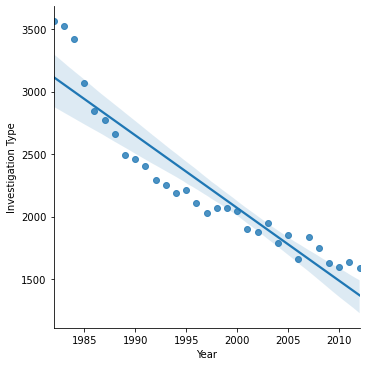

In [28]:
lmdata = pd.DataFrame(data.groupby("Year")['Investigation Type'].count()).reset_index()
lmdata['Year'] = lmdata['Year'].astype("int")
sns.lmplot(data = lmdata.iloc[6:-1], x = 'Year', y = 'Investigation Type')

This suggests a downwards trend in the number of accidents that are occuring over the years.

### Plotting the Number of Fatalities per Year

Not only did we want to see if the total number of accidents is decreasing we also wanted to see if the total number of fatalities is decreasing. This plot is seen below: 

<ipython-input-29-a302ab02c3b0>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



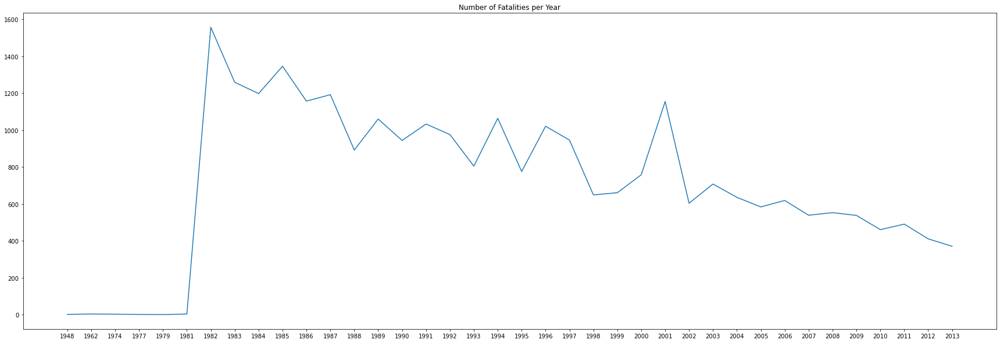

In [29]:
data['Total Fatal Injuries'] = data['Total Fatal Injuries'].astype("float")
plt.figure(figsize=(30,10))
plt.title("Number of Fatalities per Year")
plt.plot(data.groupby("Year")['Total Fatal Injuries'].sum())

#### Linear Model of above Plot

Once again, to prove that it is on a downwards trend we can look at the slope of the fitted line:

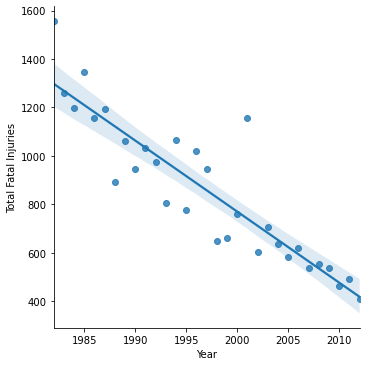

In [30]:
lmdata2 = pd.DataFrame(data.groupby("Year")['Total Fatal Injuries'].sum()).reset_index()
lmdata2['Year'] = lmdata2['Year'].astype("int")
sns.lmplot(data = lmdata2.iloc[6:-1], x = 'Year', y = 'Total Fatal Injuries')

This suggests that there has been a downwards/decreasing trend to the number of Fatalities over the years.

<b> Very Important </b> Please do not delete this cell

In [32]:
data_for_sai = data

# Model Building

### Transforming Data for Models:

In [34]:
data

,Investigation Type,Country,Latitude,Longitude,Airport Code,Airport Name,Injury Severity,Aircraft Damage,Aircraft Category,Make,...,Total Uninjured,Weather Condition,Broad Phase of Flight,Publication Date,is_fatal,Month,Day,Year,Location_City,Location_State
0,Accident,United States,30.319723,-81.514167,CRG,Jacksonville Executive Airport,Fata,Substantial,Airplane,CESSNA,...,0,IMC,NaN,12/13/2013,1,12,08,2013,Jacksonville,FL
1,Accident,United States,27.463333,-81.366667,SEF,Sebring Regional Airport,Fata,Destroyed,Helicopter,TEXAS HELICOPTER CORP,...,0,NaN,NaN,12/13/2013,1,12,06,2013,Sebring,FL
2,Accident,United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,BELLANCA,...,0,NaN,NaN,NaN,0,12,04,2013,Soldotna,AK
3,Accident,United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ANDERSON ANDREAS,...,0,NaN,NaN,NaN,0,12,03,2013,Hendersonville,NC
4,Accident,United States,33.736944,-81.818611,6J6,Edgefield County Airport,Non-Fatal,Substantial,Airplane,MOFFITT OSCAR/ KIT PROSTAR A/C,...,0,NaN,NaN,12/13/2013,0,12,02,2013,Trenton,SC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
74422,Accident,United States,NaN,NaN,NaN,NaN,Fata,Destroyed,NaN,Rockwell,...,0,IMC,CRUISE,09/12/2000,1,06,19,1977,EUREKA,CA
74423,Accident,United States,36.922223,-81.878056,NaN,NaN,Fata,Destroyed,NaN,Cessna,...,0,IMC,CRUISE,02/26/2007,1,08,30,1974,Saltville,VA
74424,Accident,United States,NaN,NaN,NaN,NaN,Fata,Destroyed,NaN,PIPER,...,0,UNK,UNKNOWN,09/19/1996,1,07,19,1962,BRIDGEPORT,CA
74425,Accident,United States,NaN,NaN,NaN,NaN,Fata,Destroyed,NaN,STINSON,...,0,UNK,CRUISE,NaN,1,10,24,1948,MOOSE CREEK,ID


We noticed that there are values that represent the same object but are in different case type. For example there is "beoing" and "BOEING". Therefore I am going to uppercase all the strings to make sure they are representing the same object:

In [35]:
data = data.applymap(lambda s: s.upper() if type(s) == str else s)
data.head()

,Investigation Type,Country,Latitude,Longitude,Airport Code,Airport Name,Injury Severity,Aircraft Damage,Aircraft Category,Make,...,Total Uninjured,Weather Condition,Broad Phase of Flight,Publication Date,is_fatal,Month,Day,Year,Location_City,Location_State
0,ACCIDENT,UNITED STATES,30.319723,-81.514167,CRG,JACKSONVILLE EXECUTIVE AIRPORT,FATA,SUBSTANTIAL,AIRPLANE,CESSNA,...,0,IMC,NaN,12/13/2013,1,12,08,2013,JACKSONVILLE,FL
1,ACCIDENT,UNITED STATES,27.463333,-81.366667,SEF,SEBRING REGIONAL AIRPORT,FATA,DESTROYED,HELICOPTER,TEXAS HELICOPTER CORP,...,0,NaN,NaN,12/13/2013,1,12,06,2013,SEBRING,FL
2,ACCIDENT,UNITED STATES,NaN,NaN,NaN,NaN,NaN,NaN,NaN,BELLANCA,...,0,NaN,NaN,NaN,0,12,04,2013,SOLDOTNA,AK
3,ACCIDENT,UNITED STATES,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ANDERSON ANDREAS,...,0,NaN,NaN,NaN,0,12,03,2013,HENDERSONVILLE,NC
4,ACCIDENT,UNITED STATES,33.736944,-81.818611,6J6,EDGEFIELD COUNTY AIRPORT,NON-FATAL,SUBSTANTIAL,AIRPLANE,MOFFITT OSCAR/ KIT PROSTAR A/C,...,0,NaN,NaN,12/13/2013,0,12,02,2013,TRENTON,SC


For my analysis with Decision Trees and Random Forests I will not consider these columns in the model: 'Country', 'Latitude', 'Longitude','Airport Name', 'Injury Severity', 'Total Fatal Injuries', 'Total Serious Injuries', 'Total Minor Injuries', 'Total Uninjured', and 'Publication Date'

In [36]:
data.drop(['Country', 'Latitude', 'Longitude','Airport Name', 'Injury Severity', 'Total Fatal Injuries',
           'Total Serious Injuries', 'Total Minor Injuries', 'Total Uninjured', 
           'Publication Date'], inplace = True, axis=1)

Here I am reorganizing the Columns to make is_fatal the last one in order to simplify the train test split.

In [37]:
# Reorganizing the Columns to make is_fatal the last one in order to simplify the train test split.
data = data[['Investigation Type', 'Airport Code', 'Aircraft Damage',
       'Aircraft Category', 'Make', 'Model', 'Amateur Built',
       'Number of Engines', 'Engine Type', 'Schedule', 'Purpose of Flight',
       'Air Carrier', 'Weather Condition', 'Broad Phase of Flight',
       'Month', 'Day', 'Year', 'Location_City', 'Location_State','is_fatal']]

Sklearn's Decision Tree and Random Forest need to LabelEncode the categorical columns. Which I did below:

In [38]:
# Need to LabelEncode all the categorical columns:
encoded_df = data[['Investigation Type', 'Airport Code', 'Aircraft Damage',
       'Aircraft Category', 'Make', 'Model', 'Amateur Built', 
      'Engine Type', 'Schedule', 'Purpose of Flight',
       'Air Carrier', 'Weather Condition', 'Broad Phase of Flight',
     'Location_City', 'Location_State']].apply(LabelEncoder().fit_transform)

numerical_df = data[['Number of Engines','Month', 'Day', 'Year','is_fatal']]

transformed_df = pd.concat([encoded_df,numerical_df],axis=1).fillna(-1)

Now that I have transformed the data I can start the train test split and model building!

In [39]:
x = transformed_df.iloc[:,:-1] # Features
y = transformed_df.iloc[:, -1] # Label

# Train Test Splitting the data
x_train, x_test, y_train, y_test = sklearn.model_selection.train_test_split(x, y, test_size = 0.2)

## Decision Tree

In [40]:
# Making Tree
decision_tree = DecisionTreeClassifier()
# Fitting Tree
decision_tree = decision_tree.fit(x_train, y_train)
# Generating Predictions from DT
preds = decision_tree.predict(x_test)

In [41]:
train_accuracy = accuracy_score(y_train, decision_tree.predict(x_train))
print("\nThe train accuracy is: " +str(train_accuracy))
    
test_accuracy = accuracy_score(y_test, preds)
print("\n\n\nThe test accuracy is: " +str(test_accuracy))


The train accuracy is: 1.0



The test accuracy is: 0.8360655737704918


In the above model I used the default parameters to create a Decision Tree Model. As we can see it may be overfitting because the training accuracy is 100% while the testing accuracy is 83%. I next need to implement some sort of hyperparameter tuning to see if we can get the DT to perform better. 

### Decision Tree with Grid Search (HyperParameter Tuning)

I want to use a hyperparameter tuning method in order to get better results. Here I create a GridSearch with the main parameters, I listed varying values in order for the model to try a wide range of possibilies:

In [42]:
# Making Tree
decision_tree = DecisionTreeClassifier()
#Creating the GridSearch
parameters = {
    'criterion': ('gini', 'entropy'),
    'splitter': ('best', 'random'),
    'max_depth': (1,2,3,5,10,15,20,25,30,35),
    'min_samples_leaf': (1,2,3,4,5),
    'max_leaf_nodes':(2,3,4,5,None)
}
clf = GridSearchCV(decision_tree, parameters)
# Fitting GridSearch / Tree
decision_tree = clf.fit(x_train, y_train)
decision_tree.best_params_

{'criterion': 'entropy',
 'max_depth': 10,
 'max_leaf_nodes': None,
 'min_samples_leaf': 2,
 'splitter': 'best'}

In [43]:
# Generating Predictions from DT
preds = decision_tree.predict(x_test)

In [44]:
train_accuracy = accuracy_score(y_train, decision_tree.predict(x_train))
print("\nThe train accuracy is: " +str(train_accuracy))
    
test_accuracy = accuracy_score(y_test, preds)
print("\n\n\nThe test accuracy is: " +str(test_accuracy))


The train accuracy is: 0.9020227895062274



The test accuracy is: 0.8853165630299604


As we can see, the Accuracy is a bit better in both cases. We can see that the model isnt overfitting the training data as much and it is also performing well on the testing set. The best parameters for this model are seen to be:  {'criterion': 'entropy',
 'max_depth': 10,
 'max_leaf_nodes': None,
 'min_samples_leaf': 2,
 'splitter': 'best'}

### Random Forest

Random Forest implements multiple Decision Trees to create its classifications. Typically this will be better since it can be tested and created amongst many trees that are created. I will implement a gridsearch for the best hyperparameters but at first I will see how the defaults perform:

In [45]:
# Making Forest
forest = RandomForestClassifier()
# Fitting Forest
forest = forest.fit(x_train, y_train)
# Generating Predictions from Forest
preds = forest.predict(x_test)

In [46]:
train_accuracy = accuracy_score(y_train, forest.predict(x_train))
print("\nThe train accuracy is: " +str(train_accuracy))
    
test_accuracy = accuracy_score(y_test, preds)
print("\n\n\nThe test accuracy is: " +str(test_accuracy))


The train accuracy is: 0.9999646674322057



The test accuracy is: 0.8895562464669304


As we can see, the testing accuracy performs great with a high testing accuracy as well. But to be sure this is not overfitting and that it is also performing the best I will implement the Hyperparameter Tuning below:

### Random Forest with Grid Search

In [50]:
# Making Forest
forest = RandomForestClassifier()
#Creating the GridSearch
parameters = {
    'criterion': ('gini', 'entropy'),
    'max_depth': (1,2,3,5,10,15,20,25,30,35),
    'min_samples_leaf': (1,2,3,4,5),
    'min_samples_leaf': (2,3,4,5),
    'max_leaf_nodes':(2,3,4,5,None),
    'max_features': ('auto', 'sqrt', 'log2')
}
clf = GridSearchCV(forest, parameters)
# Fitting GridSearch / Forest
forest = clf.fit(x_train, y_train)
forest.best_params_

{'criterion': 'gini',
 'max_depth': 20,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'min_samples_leaf': 5}

In [51]:
# Generating Predictions from Forest
preds = forest.predict(x_test)

In [52]:
train_accuracy = accuracy_score(y_train, forest.predict(x_train))
print("\nThe train accuracy is: " +str(train_accuracy))
    
test_accuracy = accuracy_score(y_test, preds)
print("\n\n\nThe test accuracy is: " +str(test_accuracy))


The train accuracy is: 0.9276212348732444



The test accuracy is: 0.892312040700961


As we can see implementing the hyperparameter tuning is decreasing the training accuracy which means that there is less overfitting, also we see the testing accuracy going up to 89%. Therefore, we will choose the Random Forest Model with the hyperparameter tuning. The parameters of this model are: {'criterion': 'gini',
 'max_depth': 20,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'min_samples_leaf': 5}. Next I will need to calculate the other statistics and not just accuracy:

In [ ]:
# confusion matrix 
confusion_matrix(y_test, preds)

**Accuracy:**\
\
(10916+1712)/(10916+1712+596+928) = **0.892312**

**Recall / True Positive Rate:**\
\
10916/(10916+596) = **0.94822**

**Specificity / True Negative Rate:**

1712/(1712+928) = **0.648484**

**Precision:**\
\
10916/(10916+928) = **0.92164**

**False Negative Rate:**\
\
596/(596+10916) = 0.05177

**False Positive Rate:**\
\
928/(928+1712) = 0.3515

## Sai's Portion

In order to make these cells run, we need to run the above portion. The `data_for_sai` comes from above, so be sure to run the Cleaning, Preprocessing, and Exploration portion!

In [33]:
print(data_for_sai.columns)

Index(['Investigation Type', 'Country', 'Latitude', 'Longitude',
       'Airport Code', 'Airport Name', 'Injury Severity', 'Aircraft Damage',
       'Aircraft Category', 'Make', 'Model', 'Amateur Built',
       'Number of Engines', 'Engine Type', 'Schedule', 'Purpose of Flight',
       'Air Carrier', 'Total Fatal Injuries', 'Total Serious Injuries',
       'Total Minor Injuries', 'Total Uninjured', 'Weather Condition',
       'Broad Phase of Flight', 'Publication Date', 'is_fatal', 'Month', 'Day',
       'Year', 'Location_City', 'Location_State'],
      dtype='object')


,Make,count
5,CESSNA,3385
9,PIPER,2411
1,BEECH,840
2,BELL,540
4,BOEING,525
7,MCDONNELL DOUGLAS,304
8,MOONEY,213
6,HUGHES,190
3,BELLANCA,175
0,AEROSPATIALE,132


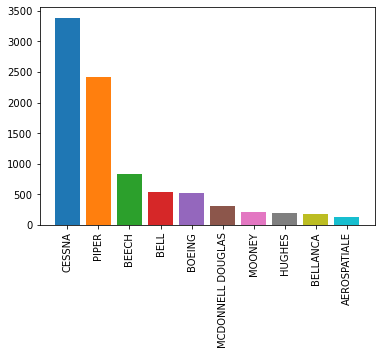

In [114]:
data_for_sai['Make'] = data_for_sai['Make'].str.upper()
result = data_for_sai.groupby('Make')['Total Serious Injuries'].sum().reset_index(name="count")
result = result.sort_values(by=['count'],ascending=False).head(10)
data_frame_with_top_10_fatalities_by_makers = result
#keys = list(df2.columns.values)
display(result)
for index, row in result.iterrows():
    plt.xticks(rotation=90)
    plt.bar(row[0],int(row[1]))

In [118]:
result = data_for_sai.groupby(['Make','Year'])['Total Serious Injuries'].sum().reset_index(name="count")
result = result.sort_values(by=['count'],ascending=False)
data_frame_with_fatalities_by_makers = result
# align indices
data_frame_with_fatalities_by_makers = data_frame_with_fatalities_by_makers.set_index(['Make'])
data_frame_with_top_10_fatalities_by_makers = data_frame_with_top_10_fatalities_by_makers.set_index(['Make'])

# calculate & apply mask
data_frame_with_fatalities_by_makers = data_frame_with_fatalities_by_makers[data_frame_with_fatalities_by_makers.index.isin(data_frame_with_top_10_fatalities_by_makers.index)].reset_index()
display(data_frame_with_fatalities_by_makers)

,Make,Year,count
0,CESSNA,1982,201
1,CESSNA,1986,198
2,CESSNA,1985,197
3,CESSNA,1983,195
4,CESSNA,1984,192
...,...,...,...
318,AEROSPATIALE,2012,0
319,PIPER,1962,0
320,MCDONNELL DOUGLAS,2000,0
321,MCDONNELL DOUGLAS,2006,0


The analysis is done by grouping the aircraft Manufacturerstogether and counting the total number of fatalities that had occured for that Particular manufacturer. The top 10 of those manufacturers are taken and represented in a bar plot as shown above.

The plot above gives the information of top 10 Aircraft manufacturers which had most fatalities.

,Make,Year,count
320,PIPER,1962,0
317,CESSNA,1974,0
277,CESSNA,1979,2
318,CESSNA,1981,0
183,MOONEY,1982,8
...,...,...,...
313,BELLANCA,2013,0
312,HUGHES,2013,0
309,MCDONNELL DOUGLAS,2013,0
221,MOONEY,2013,6


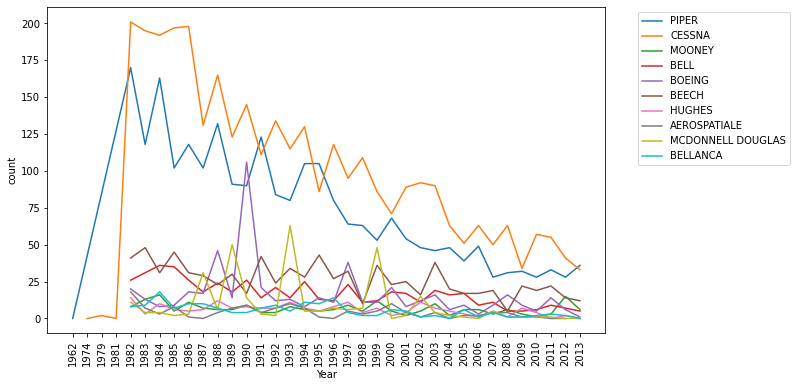

In [173]:
data_frame_with_fatalities_by_makers = data_frame_with_fatalities_by_makers.sort_values('Year')
display(data_frame_with_fatalities_by_makers)
plt.figure(figsize=(10, 6))
sns.lineplot(x='Year', y='count', data=data_frame_with_fatalities_by_makers, hue='Make')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=90)
plt.show()

,Location_State,count
6,CA,1547
63,TX,960
11,FL,894
1,AK,717
5,AZ,494
7,CO,486
48,NY,443
14,GA,389
34,MI,378
55,PA,361


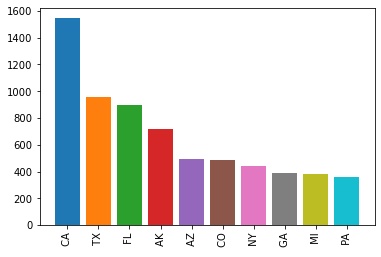

In [35]:
result = data_for_sai.groupby('Location_State')['Total Serious Injuries'].sum().reset_index(name="count")
result = result.sort_values(by=['count'],ascending=False).head(10)
display(result)
for index, row in result.iterrows():
    plt.xticks(rotation=90)
    plt.bar(row[0],int(row[1]))

Similar analysis like above is done by grouping the states where the fatalities happend and plotting top 10 among them

The plot above gives the information of top 10 U.S States which had most fatalities.

<h1> Linear Regression</h1>

In [36]:
data_for_sai.columns

Index(['Investigation Type', 'Country', 'Latitude', 'Longitude',
       'Airport Code', 'Airport Name', 'Injury Severity', 'Aircraft Damage',
       'Aircraft Category', 'Make', 'Model', 'Amateur Built',
       'Number of Engines', 'Engine Type', 'Schedule', 'Purpose of Flight',
       'Air Carrier', 'Total Fatal Injuries', 'Total Serious Injuries',
       'Total Minor Injuries', 'Total Uninjured', 'Weather Condition',
       'Broad Phase of Flight', 'Publication Date', 'is_fatal', 'Month', 'Day',
       'Year', 'Location_City', 'Location_State'],
      dtype='object')

In [39]:
data_for_sai["Weather Condition"].value_counts()

VMC    64755
IMC     5139
UNK      550
Name: Weather Condition, dtype: int64

In [40]:
data_for_sai.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 70757 entries, 0 to 74426
Data columns (total 30 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Investigation Type      70757 non-null  object 
 1   Country                 70757 non-null  object 
 2   Latitude                20291 non-null  float64
 3   Longitude               20281 non-null  float64
 4   Airport Code            41173 non-null  object 
 5   Airport Name            43972 non-null  object 
 6   Injury Severity         70701 non-null  object 
 7   Aircraft Damage         69006 non-null  object 
 8   Aircraft Category       12536 non-null  object 
 9   Make                    70730 non-null  object 
 10  Model                   70711 non-null  object 
 11  Amateur Built           70574 non-null  object 
 12  Number of Engines       69607 non-null  object 
 13  Engine Type             69781 non-null  object 
 14  Schedule                9335 non-null 

In [41]:
encoded_df = data_for_sai[[  'Aircraft Damage',
 'Make', 'Model', 'Amateur Built', 
      'Engine Type',
       'Air Carrier', 'Weather Condition', 'Broad Phase of Flight',
      'Location_State']].apply(LabelEncoder().fit_transform)

numerical_df = data_for_sai[['Number of Engines','Total Fatal Injuries','Month']]

transformed_df = pd.concat([encoded_df,numerical_df],axis=1).fillna(-1)

Re-modifying the data frame by adding the dropped attributes that helps in doing the linear regression analysis better.

In [42]:
data_for_sai.head()
X = transformed_df[[  'Aircraft Damage',
 'Make', 'Model', 'Amateur Built', 
      'Engine Type',
       'Air Carrier', 'Weather Condition', 'Broad Phase of Flight',
      'Location_State','Number of Engines','Month']]
Y = data_for_sai['Total Fatal Injuries']

Splitting the attributes for linear regression. In this case, we are trying to predict the  total fatal Injuties by considering the aircraft Damage, Make, Model, Amateur Built, Engine Type, Wether Condition etc. 

Here the predictor is - <b>Total Fatal Injuries</b>


In [50]:
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.4, random_state=101)

Splitting th data into train and test data.

In [51]:
model = LinearRegression()
model.fit(X_train,y_train)

LinearRegression()

Performing the linear regression by fitting in the model with train and test data splits

In [52]:
predictions = model.predict(X_test)
predictions

array([0.01932243, 0.03843721, 0.85571321, ..., 0.05528782, 0.25884794,
       0.03063669])

/Users/saisrinivaslakkakula/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<AxesSubplot:xlabel='Total Fatal Injuries'>

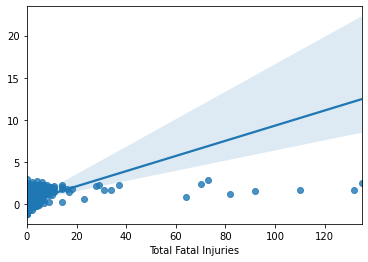

In [53]:
sns.regplot(y_test,predictions)

The plot shows the result of of prediction using linear regression model. Looking into the graph closely, we can observe that the model had predicted most of the values correctly only with very few outliers. This is because the continuous data that we've used to predict our model has the data distributed within a very less boundary from 0-10 and the distributions more concentrated from 0-5. Since the predictor is not widely spread, the linear regression model turns out predicting most of the values correctly. Below cell calculates the Root Mean Square Error (RMSE) of the model and the error is found to be 0.3

In [60]:
mean_squared_error(predictions, y_test, squared=True)

3.4164069584445502

In [70]:
from sklearn import model_selection
kfold = model_selection.KFold(n_splits=10, random_state=7, shuffle=True)
scoring = 'neg_mean_absolute_error'
results = model_selection.cross_val_score(model, X, Y, cv=kfold, scoring=scoring)
if results.mean() <0 : mae=(-1)*results.mean() 
else: mae = results.mean()
print("MAE: %.3f (%.3f)" % (mae, results.std()))

MAE: 0.428 (0.024)


### Adam's Portion

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import train_test_split
import itertools
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import cross_validate
from sklearn.metrics import regression
from sklearn.model_selection import cross_val_score
import datetime
%matplotlib inline

/Users/adam/opt/anaconda3/lib/python3.7/site-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.metrics.regression module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)


In [3]:
data = pd.read_csv("AviationData.txt", delimiter="|")
data.describe()

,Event Id,Investigation Type,Accident Number,Event Date,Location,Country,Latitude,Longitude,Airport Code,Airport Name,...,Air Carrier,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Weather Condition,Broad Phase of Flight,Report Status,Publication Date,
count,74428,74428,74428,74428,74428,74428,74428,74428,74428,74428,...,74428,74428,74428,74428,74428,74428,74428,74428,74428,74428
unique,73349,2,74428,11561,23841,171,14701,15586,9200,21565,...,2726,115,41,62,359,4,13,4,3139,1
top,20001212X19172,Accident,ERA14FA068,06/30/1984,"ANCHORAGE, AK",United States,,,,,...,,0,0,0,1,VMC,LANDING,Probable Cause,,
freq,3,71584,1,25,372,70757,53144,53153,32705,29806,...,70752,40380,42975,40358,21333,66572,17747,69938,12840,74428


In [4]:
def print_row_col(data):

    n_rows = data.shape[0]
    n_cols = data.shape[1]
    print(f"There are {n_rows} rows in the airplane crash dataset")
    print(f"There are {n_cols} columns in the airplane crash dataset")

In [5]:
def clean_data(data):

    # Drop columns that seem to have significant missing data or are not relevant
    data.drop(columns=['Event Id ', ' Registration Number ', ' Model ', ' Amateur Built ', ' FAR Description ', ' Schedule ', ' Air Carrier ', ' Broad Phase of Flight ', ' Report Status ', ' Publication Date '], inplace=True)
    data = data.iloc[:, :-1]
    # Replace missing data in columns with NaN
    data.replace(r'^\s*$', np.NaN, regex=True, inplace=True)
    # Remove extra whitespace in columns 
    data = data.apply(lambda x: x.str.strip() if x.dtype == "object" else x).rename(columns=lambda x: x.strip())
    # Decided to drop these columns
    # data.drop(columns=['Total Serious Injuries', 'Total Minor Injuries', 'Total Uninjured'], inplace=True) # Columns that appear to be primarily empty
    # Fill NaN values with zero
    data.fillna(value={'Total Fatal Injuries': 0, 'Aircraft Category': 'Airplane'}, inplace=True)
    # Convert to int
    data['Total Fatal Injuries'] = data['Total Fatal Injuries'].astype(int)
    data['is_fatal'] = data['Total Fatal Injuries'].map(lambda x: 1 if x > 0 else 0)

    data.fillna(value={'Total Serious Injuries': 0, 'Total Minor Injuries': 0, 'Total Uninjured': 0}, inplace=True)

    data['Event Date'] = pd.to_datetime(data['Event Date'])
    data['Month'] = data['Event Date'].dt.month
    data['Day'] = data['Event Date'].dt.day
    data['Year'] = data['Event Date'].dt.year
    # Drop columns that are not useful
    # data.drop(columns=['Total Serious Injuries', 'Total Minor Injuries', 'Total Uninjured'], inplace=True)
    


    return data




In [6]:
# Look at data before proprocessing
print(data.describe())
print(data.head(1))
print_row_col(data)


              Event Id   Investigation Type   Accident Number    Event Date   \
count             74428                74428             74428         74428   
unique            73349                    2             74428         11561   
top     20001212X19172             Accident        ERA14FA068    06/30/1984    
freq                  3                71584                 1            25   

              Location          Country   Latitude   Longitude   \
count             74428            74428      74428       74428   
unique            23841              171      14701       15586   
top      ANCHORAGE, AK    United States                           
freq                372            70757      53144       53153   

        Airport Code   Airport Name   ...  Air Carrier   \
count           74428          74428  ...         74428   
unique           9200          21565  ...          2726   
top                                   ...                 
freq            32705      

## Clean the data

In [7]:
# Preprocess data
data = clean_data(data)

/Users/adam/opt/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:5239: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  method=method,


## Data post preprocessing still contains significiant missing values and NaN's

In [8]:
# Look at data after proprocessing
print(data.describe())
print(data.head(1))
print_row_col(data)


       Total Fatal Injuries      is_fatal         Month           Day  \
count          74428.000000  74428.000000  74426.000000  74426.000000   
mean               0.563189      0.198608      6.577728     15.720313   
std                5.063542      0.398955      3.061183      8.833594   
min                0.000000      0.000000      1.000000      1.000000   
25%                0.000000      0.000000      4.000000      8.000000   
50%                0.000000      0.000000      7.000000     16.000000   
75%                0.000000      0.000000      9.000000     23.000000   
max              349.000000      1.000000     12.000000     31.000000   

               Year  
count  74426.000000  
mean    1995.570782  
std        9.286103  
min     1948.000000  
25%     1987.000000  
50%     1995.000000  
75%     2003.000000  
max     2013.000000  
  Investigation Type Accident Number Event Date          Location  \
0           Accident      ERA14FA068 2013-12-08  Jacksonville, FL   

     

## Count the NaN's in data

In [9]:
# Look at NaNs
print(data.isna().sum())
print(data.isna().mean()*100) # Percent of NaNs in data for each column


Investigation Type            0
Accident Number               0
Event Date                    2
Location                     89
Country                     511
Latitude                  53144
Longitude                 53153
Airport Code              32705
Airport Name              29806
Injury Severity              56
Aircraft Damage            2161
Aircraft Category             0
Make                         89
Number of Engines          3230
Engine Type                2721
Purpose of Flight          3010
Total Fatal Injuries          0
Total Serious Injuries        0
Total Minor Injuries          0
Total Uninjured               0
Weather Condition          1516
is_fatal                      0
Month                         2
Day                           2
Year                          2
dtype: int64
Investigation Type         0.000000
Accident Number            0.000000
Event Date                 0.002687
Location                   0.119579
Country                    0.686570
Latitud

## Histogram by total fatalities

AxesSubplot(0.125,0.125;0.775x0.755)
count     54.000000
mean     160.500000
std       57.931889
min      102.000000
25%      118.750000
50%      144.500000
75%      172.750000
max      349.000000
Name: Total Fatal Injuries, dtype: float64


54

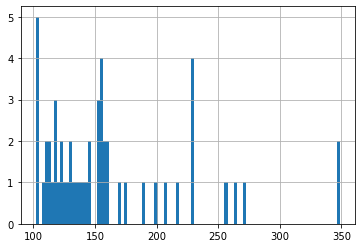

In [10]:
# Looking at histogram of fatal injuries above 100
print(data[data['Total Fatal Injuries'] > 100]['Total Fatal Injuries'].hist(bins=100))
print(data[data['Total Fatal Injuries'] > 100]['Total Fatal Injuries'].describe())
# looking at only plane crashes with greater than 100 fatalities
len(data[data['Total Fatal Injuries'] > 100]) # Dropped down to 54 plane crashes

In [11]:
# Make new dataframe filtered by > 25 Total Fatal Injuries
data_sig_fatal = data[data['Total Fatal Injuries'] > 25] # Drop to only crashes including more than 25 fatalities

In [12]:
data.loc[data['Event Date']=='09/11/2001'] # Looking at 9/11 attacks 
data.loc[data['Event Date']=='09/11/2001']['Total Fatal Injuries'] # Looking at 9/11 attacks


22942    44
22943    64
22944    65
22945    92
Name: Total Fatal Injuries, dtype: int64

In [13]:
data['Country'].value_counts()
# Interesting to see most of the large plane crashes are in the US folowed by Colombia, Peru, Nigeria
print(data.head(1))

  Investigation Type Accident Number Event Date          Location  \
0           Accident      ERA14FA068 2013-12-08  Jacksonville, FL   

         Country   Latitude   Longitude Airport Code  \
0  United States  30.319723  -81.514167          CRG   

                     Airport Name Injury Severity  ... Purpose of Flight  \
0  Jacksonville Executive Airport        Fatal(3)  ...          Personal   

  Total Fatal Injuries Total Serious Injuries Total Minor Injuries  \
0                    3                      0                    0   

  Total Uninjured Weather Condition  is_fatal Month  Day    Year  
0               0               IMC         1  12.0  8.0  2013.0  

[1 rows x 25 columns]


# Check fatality rate for plane crashes?
# Is Fatal?
# Are flights overall becoming more safe?
# Are large planes safer than small planes?
# Is it dangerous to fly in bad weather?

<!-- Narrow to United states
Lat/Long only 30% of data
Plot by state maybe
Fatality rate {by_state, by_plane_type, by_year, by_weather}
Build classifier based off US to predict fatalities -->

In [14]:
# Add column is_fatal
US_accidents = data[data['Country'] == 'United States']
US_accidents

,Investigation Type,Accident Number,Event Date,Location,Country,Latitude,Longitude,Airport Code,Airport Name,Injury Severity,...,Purpose of Flight,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Weather Condition,is_fatal,Month,Day,Year
0,Accident,ERA14FA068,2013-12-08,"Jacksonville, FL",United States,30.319723,-81.514167,CRG,Jacksonville Executive Airport,Fatal(3),...,Personal,3,0,0,0,IMC,1,12.0,8.0,2013.0
1,Accident,ERA14FA066,2013-12-06,"Sebring, FL",United States,27.463333,-81.366667,SEF,Sebring Regional Airport,Fatal(1),...,Positioning,1,0,0,0,NaN,1,12.0,6.0,2013.0
2,Accident,ANC14CA010,2013-12-04,"Soldotna, AK",United States,NaN,NaN,NaN,NaN,NaN,...,NaN,0,0,0,0,NaN,0,12.0,4.0,2013.0
3,Accident,ERA14CA062,2013-12-03,"Hendersonville, NC",United States,NaN,NaN,NaN,NaN,NaN,...,NaN,0,0,0,0,NaN,0,12.0,3.0,2013.0
4,Accident,ERA14LA059,2013-12-02,"Trenton, SC",United States,33.736944,-81.818611,6J6,Edgefield County Airport,Non-Fatal,...,Personal,0,0,1,0,NaN,0,12.0,2.0,2013.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
74422,Accident,LAX96LA321,1977-06-19,"EUREKA, CA",United States,NaN,NaN,NaN,NaN,Fatal(2),...,Personal,2,0,0,0,IMC,1,6.0,19.0,1977.0
74423,Accident,NYC07LA005,1974-08-30,"Saltville, VA",United States,36.922223,-81.878056,NaN,NaN,Fatal(3),...,Personal,3,0,0,0,IMC,1,8.0,30.0,1974.0
74424,Accident,LAX94LA336,1962-07-19,"BRIDGEPORT, CA",United States,NaN,NaN,NaN,NaN,Fatal(4),...,Personal,4,0,0,0,UNK,1,7.0,19.0,1962.0
74425,Accident,SEA87LA080,1948-10-24,"MOOSE CREEK, ID",United States,NaN,NaN,NaN,NaN,Fatal(2),...,Personal,2,0,0,0,UNK,1,10.0,24.0,1948.0


## Look at frequency of plane crashes by state

 CA              7811
 FL              4938
 AK              4912
 TX              4910
 AZ              2410
                 ... 
Kauai               1
 San Juan Is.       1
 Maui               1
 MP                 1
 FT. MYER           1
Name: Location_State, Length: 79, dtype: int64


/Users/adam/opt/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:3636: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


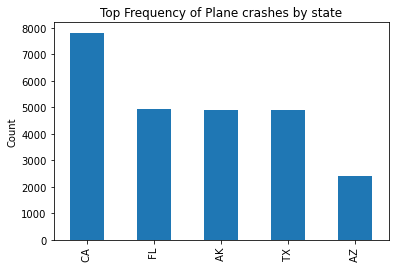

In [15]:
# Location (Stolen from Ryan's notebook)
US_accidents[['Location_City','Location_State']] = US_accidents['Location'].str.split(',',expand=True)[[0,1]]
US_accidents[['Location','Location_City','Location_State']].head()

US_accidents.groupby(['Location_State']).count()

freq_by_state = US_accidents['Location_State'].value_counts()
print(freq_by_state)
freq_by_state[:5].plot(kind='bar', title='Top Frequency of Plane crashes by state', ylabel='Count')



Looking by state, CA is by far the greatest frequency. Could be due to highest population.

In [16]:
def plot_frequency_by_state(data, title, ylabel):
    # plot frequency of crashes by state
    freq_by_state = data['Location_State'].value_counts()
    print(freq_by_state)
    freq_by_state[:5].plot(kind='bar', title=title, ylabel=ylabel)


In [17]:
def plot_frequency_by_country(data, title, ylabel):
    # plot frequency of crashes by country
    
    freq_by_country = data['Country'].value_counts()
    print(freq_by_country)
    freq_by_country[:5].plot(kind='bar', title=title, ylabel=ylabel)

United States    70757
Canada             204
Mexico             188
Bahamas            182
Australia          158
                 ...  
Eritrea              1
Ivory Coast          1
Niger                1
Madagascar           1
Bermuda              1
Name: Country, Length: 170, dtype: int64


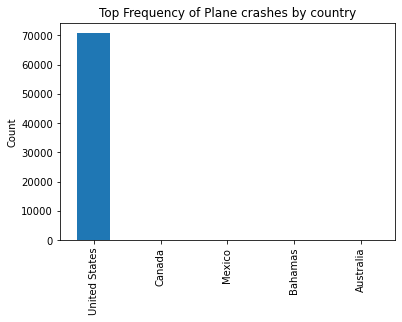

In [18]:
plot_frequency_by_country(data, 'Top Frequency of Plane crashes by country', 'Count')


# Looking at the top 5 countries with the most plane crashes
# US is the most common country with the most plane crashes
# Followed by China, India, and Russia

It appears that more than 90% of the crashes in the dataset are from the United States. Due to this, we will focus our analysis on US
Crash Data. 

## Logistic Regression to Predict if plane crash is fatal or not


In [19]:
print(US_accidents.columns)
print(US_accidents.dtypes)
print(US_accidents.head())

Index(['Investigation Type', 'Accident Number', 'Event Date', 'Location',
       'Country', 'Latitude', 'Longitude', 'Airport Code', 'Airport Name',
       'Injury Severity', 'Aircraft Damage', 'Aircraft Category', 'Make',
       'Number of Engines', 'Engine Type', 'Purpose of Flight',
       'Total Fatal Injuries', 'Total Serious Injuries',
       'Total Minor Injuries', 'Total Uninjured', 'Weather Condition',
       'is_fatal', 'Month', 'Day', 'Year', 'Location_City', 'Location_State'],
      dtype='object')
Investigation Type                object
Accident Number                   object
Event Date                datetime64[ns]
Location                          object
Country                           object
Latitude                          object
Longitude                         object
Airport Code                      object
Airport Name                      object
Injury Severity                   object
Aircraft Damage                   object
Aircraft Category                

In [20]:
# Filling NaNs with most frequent
US_accidents['Weather Condtion'] = US_accidents['Weather Condition'].fillna(US_accidents.mode().iloc[0])
US_accidents

ipykernel_launcher:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


,Investigation Type,Accident Number,Event Date,Location,Country,Latitude,Longitude,Airport Code,Airport Name,Injury Severity,...,Total Minor Injuries,Total Uninjured,Weather Condition,is_fatal,Month,Day,Year,Location_City,Location_State,Weather Condtion
0,Accident,ERA14FA068,2013-12-08,"Jacksonville, FL",United States,30.319723,-81.514167,CRG,Jacksonville Executive Airport,Fatal(3),...,0,0,IMC,1,12.0,8.0,2013.0,Jacksonville,FL,IMC
1,Accident,ERA14FA066,2013-12-06,"Sebring, FL",United States,27.463333,-81.366667,SEF,Sebring Regional Airport,Fatal(1),...,0,0,NaN,1,12.0,6.0,2013.0,Sebring,FL,NaN
2,Accident,ANC14CA010,2013-12-04,"Soldotna, AK",United States,NaN,NaN,NaN,NaN,NaN,...,0,0,NaN,0,12.0,4.0,2013.0,Soldotna,AK,NaN
3,Accident,ERA14CA062,2013-12-03,"Hendersonville, NC",United States,NaN,NaN,NaN,NaN,NaN,...,0,0,NaN,0,12.0,3.0,2013.0,Hendersonville,NC,NaN
4,Accident,ERA14LA059,2013-12-02,"Trenton, SC",United States,33.736944,-81.818611,6J6,Edgefield County Airport,Non-Fatal,...,1,0,NaN,0,12.0,2.0,2013.0,Trenton,SC,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
74422,Accident,LAX96LA321,1977-06-19,"EUREKA, CA",United States,NaN,NaN,NaN,NaN,Fatal(2),...,0,0,IMC,1,6.0,19.0,1977.0,EUREKA,CA,IMC
74423,Accident,NYC07LA005,1974-08-30,"Saltville, VA",United States,36.922223,-81.878056,NaN,NaN,Fatal(3),...,0,0,IMC,1,8.0,30.0,1974.0,Saltville,VA,IMC
74424,Accident,LAX94LA336,1962-07-19,"BRIDGEPORT, CA",United States,NaN,NaN,NaN,NaN,Fatal(4),...,0,0,UNK,1,7.0,19.0,1962.0,BRIDGEPORT,CA,UNK
74425,Accident,SEA87LA080,1948-10-24,"MOOSE CREEK, ID",United States,NaN,NaN,NaN,NaN,Fatal(2),...,0,0,UNK,1,10.0,24.0,1948.0,MOOSE CREEK,ID,UNK


In [21]:

#Fill Nan's with most frequent damage value of 'Substantial'
US_accidents['Aircraft Damage'].value_counts()
US_accidents['Aircraft Damage'].fillna('Substantial', inplace=True) # Assume NaNs are VMC conditions
# Map strings to ints
US_accidents['Aircraft Damage'] = US_accidents['Aircraft Damage'].map({'Substantial': 1, 'Destroyed': 2, 'Minor': 0})
US_accidents['Aircraft Damage'].unique()

/Users/adam/opt/anaconda3/lib/python3.7/site-packages/pandas/core/generic.py:6392: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return self._update_inplace(result)
ipykernel_launcher:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([1, 2, 0])

In [22]:
US_accidents['Number of Engines'].value_counts()
US_accidents['Number of Engines'].fillna(1, inplace=True)
US_accidents['Number of Engines'] = US_accidents['Number of Engines'].astype(int)
US_accidents['Number of Engines'].unique()

ipykernel_launcher:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([2, 1, 4, 0, 3])

In [23]:
## Convert NaNs to most frequent value


US_accidents['Weather Condition'].value_counts()
US_accidents['Weather Condition'].fillna('VMC', inplace=True) # Assume NaNs are VMC conditions
US_accidents['Weather Condition'].isna().sum()
US_accidents['Weather Condition'] = US_accidents['Weather Condition'].map({'IMC': 0, 'VMC': 1, 'UNK': 2})
US_accidents['Weather Condition'].unique()

ipykernel_launcher:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([0, 1, 2])

# Logistic Regression

In [24]:
# x = US_accidents[['Aircraft Damage', 'Aircraft Category', 'Number of Engines', 'Purpose of Flight', 'Weather Condition']]
# initialize columns for training
x = US_accidents[['Aircraft Damage', 'Number of Engines', 'Weather Condition']]
y = US_accidents['is_fatal']

In [25]:
# Generate the model
model = LogisticRegression(solver='liblinear', random_state=0)

In [26]:
# Split the data into training and testing sets
x_train, x_test, y_train, y_test =\
    train_test_split(x, y, test_size=0.2, random_state=0)
# Fit the model
model.fit(x_train,y_train)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=0, solver='liblinear', tol=0.0001, verbose=0,
                   warm_start=False)

Model classes

87% Accuracy score. Can this be improved on?

In [27]:
print(model.classes_)
print(model.predict_proba(x_test))
y_pred = model.predict(x_test)
print(model.score(x_train, y_train))
print(model.score(x_test, y_test))

[0 1]
[[0.40275891 0.59724109]
 [0.94184335 0.05815665]
 [0.94184335 0.05815665]
 ...
 [0.94184335 0.05815665]
 [0.36815062 0.63184938]
 [0.99602937 0.00397063]]
0.874940376291847
0.8719615602035048


In [28]:
confusion_matrix(y_test, y_pred)

array([[10420,  1072],
       [  740,  1920]])

### Function to plot the confusion matrix


In [29]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """ This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`. """
    # Compute the normalized confusion matrix
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')
    
    fig, ax = plt.subplots(figsize=(8, 8))
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')
    
    

### Function to plot the ROC curve

In [30]:
def plot_auc(model, x_test):
    # Plot the ROC curve
    y_pred = model.predict_proba(x_test)
    y_pred = y_pred[:, 1]
    fpr, tpr, thresholds = roc_curve(y_test, y_pred)
    auc = roc_auc_score(y_test, y_pred)
    plt.plot(fpr, tpr, color='orange', label='ROC')
    plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    plt.legend()
    plt.show()
    print(f"The AUC score is {auc}")

              precision    recall  f1-score   support

           0       0.93      0.91      0.92     11492
           1       0.64      0.72      0.68      2660

    accuracy                           0.87     14152
   macro avg       0.79      0.81      0.80     14152
weighted avg       0.88      0.87      0.87     14152

[[10420  1072]
 [  740  1920]]
0.09328228332753219
0.7218045112781954


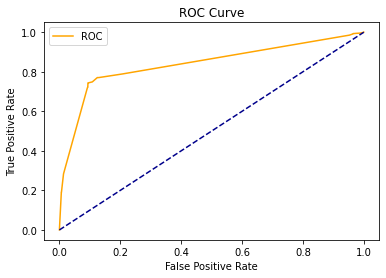

The AUC score is 0.8389496354443366
Normalized confusion matrix


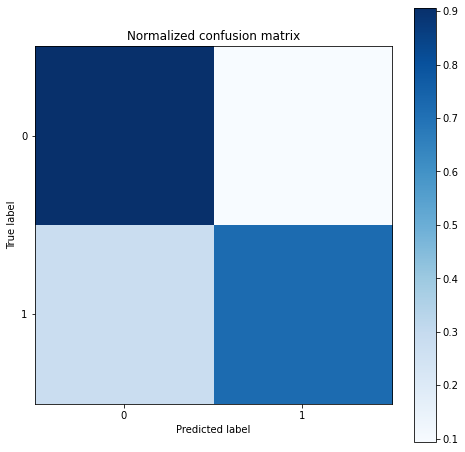

In [31]:
print(classification_report(y_test, y_pred))
cm = confusion_matrix(y_test, y_pred)
print(cm)
fpr = cm[0][1] / (cm[0][1] + cm[0][0])
print(fpr)
tpr = cm[1][1] / (cm[1][1] + cm[1][0])
print(tpr)
plot_auc(model, x_test)
# plot_roc_curve(fpr, tpr)
plot_confusion_matrix(cm, classes=['0', '1'], normalize=True, title='Normalized confusion matrix')


Confusion Matrix shows the accuracy of the model.
The diagonal shows the true positive rate (TP) and the false positive rate (FP).
There appears to be a significant number of true positives and true negatives
This is a good model to use for binary classification problems.


In [32]:
print(classification_report(y, model.predict(x)))
cv_results = cross_validate(model, x_test, y_test, cv=5)
print(sorted(cv_results.keys()))
print(cv_results['test_score'])
cv_results_train = cross_validate(model, x_train, y_train, cv=5)
print(cv_results['test_score'])
print(f"The accuracy of the model was {cv_results['test_score'].mean()} with a standard deviation of {cv_results['test_score'].std()} ")

              precision    recall  f1-score   support

           0       0.94      0.91      0.92     57668
           1       0.64      0.73      0.68     13089

    accuracy                           0.87     70757
   macro avg       0.79      0.82      0.80     70757
weighted avg       0.88      0.87      0.88     70757

['fit_time', 'score_time', 'test_score']
[0.87036383 0.8700106  0.87385159 0.87349823 0.87208481]
[0.87036383 0.8700106  0.87385159 0.87349823 0.87208481]
The accuracy of the model was 0.8719618109946291 with a standard deviation of 0.0015689339411438287 


When performing Cross validation score, we used a k fold cross validation.
We had a k value of 5 in this case.
Each scoring value had a consistent accuracy score of around 87%.


In [33]:
# Logistic Regression with GridSearchCV
clf = GridSearchCV(LogisticRegression(solver='liblinear', random_state=0),
                   param_grid={'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000], 'penalty': ['l1', 'l2'],
                                'max_iter': [100, 200, 300, 400, 500, 600, 700, 800, 900, 1000],
                                'tol': [1e-6, 1e-3]},
                   cv=5)
clf.fit(x_train, y_train)


print(f"The best parameters for the model are {clf.best_params_}")
print(clf.best_score_)
print(clf.score(x_test, y_test))

The best parameters for the model are {'C': 0.01, 'max_iter': 100, 'penalty': 'l1', 'tol': 1e-06}
0.8749403762918471
0.8719615602035048


In [34]:

model = LogisticRegression(penalty='l2',  tol=1e-6, random_state=0).fit(x_train, y_train)

print(f"The model score for testing dataset is {model.score(x_test, y_test)}")
print(f"The model score for training dataset is {model.score(x_train, y_train)}")
print(f"The model coeffiecents are {model.coef_}")
print(f"The model intercept is {model.intercept_}")

print(model.predict_proba(x_test))


The model score for testing dataset is 0.8719615602035048
The model score for training dataset is 0.874940376291847
The model coeffiecents are [[ 3.1846745   0.15363686 -1.12091625]]
The model intercept is [-5.00631981]
[[0.40233392 0.59766608]
 [0.94207439 0.05792561]
 [0.94207439 0.05792561]
 ...
 [0.94207439 0.05792561]
 [0.36600672 0.63399328]
 [0.99598097 0.00401903]]


              precision    recall  f1-score   support

           0       0.93      0.91      0.92     11492
           1       0.64      0.72      0.68      2660

    accuracy                           0.87     14152
   macro avg       0.79      0.81      0.80     14152
weighted avg       0.88      0.87      0.87     14152

[[10420  1072]
 [  740  1920]]
0.09328228332753219
0.7218045112781954


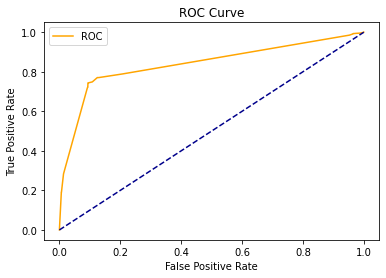

The AUC score is 0.8389496354443366
Normalized confusion matrix


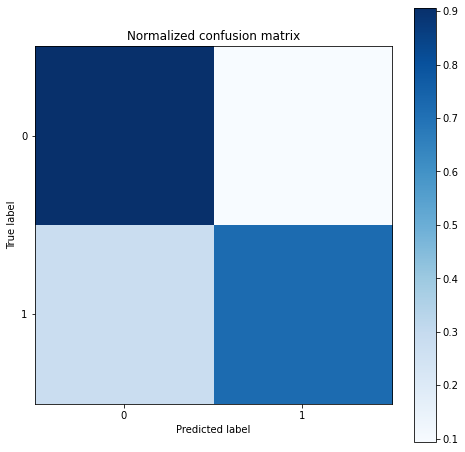

In [35]:
y_pred = model.predict(x_test)
print(classification_report(y_test, y_pred))
cm = confusion_matrix(y_test, y_pred)
print(cm)
fpr = cm[0][1] / (cm[0][1] + cm[0][0])
print(fpr)
tpr = cm[1][1] / (cm[1][1] + cm[1][0])
print(tpr)
plot_auc(model, x_test)
plot_confusion_matrix(cm, classes=['0', '1'], normalize=True, title='Normalized confusion matrix')


In [36]:
def plot_probability_distribution(model, x_test):
    y_pred = model.predict_proba(x_test)
    y_pred = y_pred[:, 1]
    plt.hist(y_pred, bins=20, range=(0, 1))
    plt.xlabel('Probability')
    plt.ylabel('Frequency')
    plt.title('Probability Distribution')
    plt.show()
    

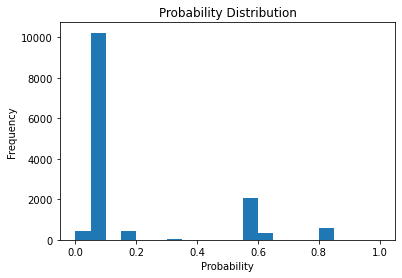

In [37]:
plot_probability_distribution(model, x_test)

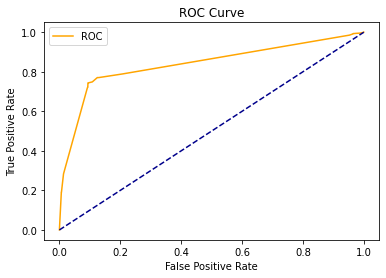

The AUC score is 0.8389496354443366


In [38]:
plot_auc(model, x_test)

In [43]:
def correlation_heatmap(df):
    _, ax = plt.subplots(figsize=(10, 8))
    colormap = sns.diverging_palette(220, 10, as_cmap=True)
    _ = sns.heatmap(df.corr(), cmap=colormap, square=True, cbar_kws={'shrink': .9}, ax=ax, annot=True, linewidths=0.1, vmax=1.0, linecolor='white', annot_kws={'fontsize': 12})
    plt.show()

#correlation_heatmap(x_train)
print(x_train.corr())
print(US_accidents.corr())

                   Aircraft Damage  Number of Engines  Weather Condition
Aircraft Damage           1.000000          -0.064785          -0.183281
Number of Engines        -0.064785           1.000000          -0.134418
Weather Condition        -0.183281          -0.134418           1.000000
                      Aircraft Damage  Number of Engines  \
Aircraft Damage              1.000000          -0.064249   
Number of Engines           -0.064249           1.000000   
Total Fatal Injuries         0.215738           0.084274   
Weather Condition           -0.182293          -0.137484   
is_fatal                     0.579756           0.038210   
Month                        0.014668          -0.020287   
Day                          0.001529          -0.003640   
Year                        -0.155615          -0.030375   

                      Total Fatal Injuries  Weather Condition  is_fatal  \
Aircraft Damage                   0.215738          -0.182293  0.579756   
Number of Engines

Not a significant improvement in model accuracy after running grid search to optimize hyperparameters.


### Ratika's Portion

In [1]:
import pandas as pd
import numpy as np
pd.set_option('display.max_columns', None)
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from bioinfokit.visuz import cluster
import plotly.express as px
import prince


import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style()
%matplotlib inline
import altair as alt


import warnings
warnings.filterwarnings("ignore")

In [2]:
df = pd.read_csv("AviationData.txt", delimiter="|")

In [3]:
df.head()

,Event Id,Investigation Type,Accident Number,Event Date,Location,Country,Latitude,Longitude,Airport Code,Airport Name,Injury Severity,Aircraft Damage,Aircraft Category,Registration Number,Make,Model,Amateur Built,Number of Engines,Engine Type,FAR Description,Schedule,Purpose of Flight,Air Carrier,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Weather Condition,Broad Phase of Flight,Report Status,Publication Date,
0,20131208X92103,Accident,ERA14FA068,12/08/2013,"Jacksonville, FL",United States,30.319723,-81.514167,CRG,Jacksonville Executive Airport,Fatal(3),Substantial,Airplane,N98BT,CESSNA,310R,No,2,Reciprocating,Part 91: General Aviation,,Personal,,3,,,,IMC,,Preliminary,12/13/2013,
1,20131206X95526,Accident,ERA14FA066,12/06/2013,"Sebring, FL",United States,27.463333,-81.366667,SEF,Sebring Regional Airport,Fatal(1),Destroyed,Helicopter,N1001N,TEXAS HELICOPTER CORP,M74L,No,1,Unknown,Part 91: General Aviation,,Positioning,,1,,,,,,Preliminary,12/13/2013,
2,20131205X60841,Accident,ANC14CA010,12/04/2013,"Soldotna, AK",United States,,,,,,,,N88342,BELLANCA,7GCBC,,,,,,,,,,,,,,Preliminary,,
3,20131204X65412,Accident,ERA14CA062,12/03/2013,"Hendersonville, NC",United States,,,,,,,,N581TC,ANDERSON ANDREAS,RANS S-6S,,,,,,,,,,,,,,Preliminary,,
4,20131202X34203,Accident,ERA14LA059,12/02/2013,"Trenton, SC",United States,33.736944,-81.818611,6J6,Edgefield County Airport,Non-Fatal,Substantial,Airplane,N355PT,MOFFITT OSCAR/ KIT PROSTAR A/C,PT2,Yes,1,,Part 91: General Aviation,,Personal,,,,1,,,,Preliminary,12/13/2013,


In [4]:
df.columns

Index(['Event Id ', ' Investigation Type ', ' Accident Number ',
       ' Event Date ', ' Location ', ' Country ', ' Latitude ', ' Longitude ',
       ' Airport Code ', ' Airport Name ', ' Injury Severity ',
       ' Aircraft Damage ', ' Aircraft Category ', ' Registration Number ',
       ' Make ', ' Model ', ' Amateur Built ', ' Number of Engines ',
       ' Engine Type ', ' FAR Description ', ' Schedule ',
       ' Purpose of Flight ', ' Air Carrier ', ' Total Fatal Injuries ',
       ' Total Serious Injuries ', ' Total Minor Injuries ',
       ' Total Uninjured ', ' Weather Condition ', ' Broad Phase of Flight ',
       ' Report Status ', ' Publication Date ', ' '],
      dtype='object')

In [5]:
columns_drop = ['Event Id ', ' Accident Number ', ' Registration Number ', ' Publication Date ']
df.drop(columns = columns_drop, inplace = True)

In [6]:
df.replace("  ", np.NaN, inplace = True)
df = df.apply(lambda x: x.str.strip() if x.dtype == "object" else x).rename(columns=lambda x: x.strip())
df.head()

,Investigation Type,Event Date,Location,Country,Latitude,Longitude,Airport Code,Airport Name,Injury Severity,Aircraft Damage,Aircraft Category,Make,Model,Amateur Built,Number of Engines,Engine Type,FAR Description,Schedule,Purpose of Flight,Air Carrier,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Weather Condition,Broad Phase of Flight,Report Status,
0,Accident,12/08/2013,"Jacksonville, FL",United States,30.319723,-81.514167,CRG,Jacksonville Executive Airport,Fatal(3),Substantial,Airplane,CESSNA,310R,No,2,Reciprocating,Part 91: General Aviation,NaN,Personal,NaN,3,NaN,NaN,NaN,IMC,NaN,Preliminary,
1,Accident,12/06/2013,"Sebring, FL",United States,27.463333,-81.366667,SEF,Sebring Regional Airport,Fatal(1),Destroyed,Helicopter,TEXAS HELICOPTER CORP,M74L,No,1,Unknown,Part 91: General Aviation,NaN,Positioning,NaN,1,NaN,NaN,NaN,NaN,NaN,Preliminary,
2,Accident,12/04/2013,"Soldotna, AK",United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,BELLANCA,7GCBC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Preliminary,
3,Accident,12/03/2013,"Hendersonville, NC",United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ANDERSON ANDREAS,RANS S-6S,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Preliminary,
4,Accident,12/02/2013,"Trenton, SC",United States,33.736944,-81.818611,6J6,Edgefield County Airport,Non-Fatal,Substantial,Airplane,MOFFITT OSCAR/ KIT PROSTAR A/C,PT2,Yes,1,NaN,Part 91: General Aviation,NaN,Personal,NaN,NaN,NaN,1,NaN,NaN,NaN,Preliminary,


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74428 entries, 0 to 74427
Data columns (total 28 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   Investigation Type      74428 non-null  object
 1   Event Date              74426 non-null  object
 2   Location                74339 non-null  object
 3   Country                 73917 non-null  object
 4   Latitude                21284 non-null  object
 5   Longitude               21275 non-null  object
 6   Airport Code            41723 non-null  object
 7   Airport Name            44622 non-null  object
 8   Injury Severity         74372 non-null  object
 9   Aircraft Damage         72267 non-null  object
 10  Aircraft Category       13655 non-null  object
 11  Make                    74339 non-null  object
 12  Model                   74307 non-null  object
 13  Amateur Built           73936 non-null  object
 14  Number of Engines       71198 non-null  object
 15  En

In [8]:
#Drop Columns where more than 50% values are null

df.drop(['Latitude', 'Longitude', 'Aircraft Category', 'FAR Description', 'Schedule', 'Air Carrier'], inplace = True, axis = 1)
df.shape

(74428, 22)

In [9]:
df.head()

,Investigation Type,Event Date,Location,Country,Airport Code,Airport Name,Injury Severity,Aircraft Damage,Make,Model,Amateur Built,Number of Engines,Engine Type,Purpose of Flight,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Weather Condition,Broad Phase of Flight,Report Status,
0,Accident,12/08/2013,"Jacksonville, FL",United States,CRG,Jacksonville Executive Airport,Fatal(3),Substantial,CESSNA,310R,No,2,Reciprocating,Personal,3,NaN,NaN,NaN,IMC,NaN,Preliminary,
1,Accident,12/06/2013,"Sebring, FL",United States,SEF,Sebring Regional Airport,Fatal(1),Destroyed,TEXAS HELICOPTER CORP,M74L,No,1,Unknown,Positioning,1,NaN,NaN,NaN,NaN,NaN,Preliminary,
2,Accident,12/04/2013,"Soldotna, AK",United States,NaN,NaN,NaN,NaN,BELLANCA,7GCBC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Preliminary,
3,Accident,12/03/2013,"Hendersonville, NC",United States,NaN,NaN,NaN,NaN,ANDERSON ANDREAS,RANS S-6S,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Preliminary,
4,Accident,12/02/2013,"Trenton, SC",United States,6J6,Edgefield County Airport,Non-Fatal,Substantial,MOFFITT OSCAR/ KIT PROSTAR A/C,PT2,Yes,1,NaN,Personal,NaN,NaN,1,NaN,NaN,NaN,Preliminary,


In [10]:
df.isna().sum()

Investigation Type            0
Event Date                    2
Location                     89
Country                     511
Airport Code              32705
Airport Name              29806
Injury Severity              56
Aircraft Damage            2161
Make                         89
Model                       121
Amateur Built               492
Number of Engines          3230
Engine Type                2721
Purpose of Flight          3010
Total Fatal Injuries      19266
Total Serious Injuries    21077
Total Minor Injuries      20157
Total Uninjured           10088
Weather Condition          1516
Broad Phase of Flight      6071
Report Status                 0
                              0
dtype: int64

In [11]:
#connverting numerical data to int type
df['Total Fatal Injuries'] = df['Total Fatal Injuries'].fillna(0).astype("int")
df['Total Serious Injuries'] = df['Total Serious Injuries'].fillna(0).astype("int")
df['Total Minor Injuries'] = df['Total Minor Injuries'].fillna(0).astype("int")
df['Total Uninjured'] = df['Total Uninjured'].fillna(0).astype("int")
df.loc[df['Injury Severity'].notnull()][['Total Fatal Injuries', 'Total Serious Injuries', 'Total Minor Injuries','Total Uninjured', 'Injury Severity']]


,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Injury Severity
0,3,0,0,0,Fatal(3)
1,1,0,0,0,Fatal(1)
4,0,0,1,0,Non-Fatal
5,1,0,0,0,Fatal(1)
6,0,0,0,0,Unavailable
...,...,...,...,...,...
74423,3,0,0,0,Fatal(3)
74424,4,0,0,0,Fatal(4)
74425,2,0,0,0,Fatal(2)
74426,0,0,0,1,Non-Fatal


In [12]:
df = df[df['Event Date'].notna()]

In [13]:
df[['Month','Day','Year']] = df['Event Date'].str.split('/',expand=True)

In [14]:
df['Month'] = df['Month'].astype("int")
df['Day'] = df['Day'].astype("int")
df['Year'] = df['Year'].astype("int")

In [15]:
df['Injury Severity'].unique()

array(['Fatal(3)', 'Fatal(1)', nan, 'Non-Fatal', 'Unavailable',
       'Fatal(4)', 'Incident', 'Fatal(2)', 'Fatal(5)', 'Fatal(14)',
       'Fatal(7)', 'Fatal(10)', 'Fatal(6)', 'Fatal(9)', 'Fatal(8)',
       'Fatal(19)', 'Fatal(153)', 'Fatal(127)', 'Fatal(28)', 'Fatal(11)',
       'Fatal(77)', 'Fatal(12)', 'Fatal(21)', 'Fatal(42)', 'Fatal(157)',
       'Fatal(158)', 'Fatal(103)', 'Fatal(89)', 'Fatal(90)', 'Fatal(152)',
       'Fatal(228)', 'Fatal(17)', 'Fatal(13)', 'Fatal(50)', 'Fatal(24)',
       'Fatal(88)', 'Fatal(65)', 'Fatal(154)', 'Fatal(30)', 'Fatal(20)',
       'Fatal(40)', 'Fatal(57)', 'Fatal(199)', 'Fatal(114)', 'Fatal(23)',
       'Fatal(102)', 'Fatal(96)', 'Fatal(49)', 'Fatal(124)', 'Fatal(107)',
       'Fatal(117)', 'Fatal(145)', 'Fatal(45)', 'Fatal(160)',
       'Fatal(121)', 'Fatal(16)', 'Fatal(15)', 'Fatal(104)', 'Fatal(25)',
       'Fatal(55)', 'Fatal(46)', 'Fatal(141)', 'Fatal(115)', 'Fatal(75)',
       'Fatal(71)', 'Fatal(206)', 'Fatal(138)', 'Fatal(92)', 'Fatal(26)',

In [16]:
def cleanInjury(x):
    if pd.isna(x):
        return 'Unavailable'
    return 'Fatal' if 'Fatal' in x and 'Non' not in x else x

In [17]:
df['Injury Severity'] = df['Injury Severity'].apply(lambda x: cleanInjury(x))
df['Injury Severity'].unique()

array(['Fatal', 'Unavailable', 'Non-Fatal', 'Incident'], dtype=object)

In [18]:
df = df[df['Injury Severity']!='Unavailable']
df.head()

,Investigation Type,Event Date,Location,Country,Airport Code,Airport Name,Injury Severity,Aircraft Damage,Make,Model,Amateur Built,Number of Engines,Engine Type,Purpose of Flight,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Weather Condition,Broad Phase of Flight,Report Status,,Month,Day,Year
0,Accident,12/08/2013,"Jacksonville, FL",United States,CRG,Jacksonville Executive Airport,Fatal,Substantial,CESSNA,310R,No,2,Reciprocating,Personal,3,0,0,0,IMC,NaN,Preliminary,,12,8,2013
1,Accident,12/06/2013,"Sebring, FL",United States,SEF,Sebring Regional Airport,Fatal,Destroyed,TEXAS HELICOPTER CORP,M74L,No,1,Unknown,Positioning,1,0,0,0,NaN,NaN,Preliminary,,12,6,2013
4,Accident,12/02/2013,"Trenton, SC",United States,6J6,Edgefield County Airport,Non-Fatal,Substantial,MOFFITT OSCAR/ KIT PROSTAR A/C,PT2,Yes,1,NaN,Personal,0,0,1,0,NaN,NaN,Preliminary,,12,2,2013
5,Accident,12/02/2013,"Dawsonville, GA",United States,NaN,N/A,Fatal,Destroyed,PIPER,PA 46-310P,No,1,Turbo Prop,Personal,1,0,0,0,IMC,NaN,Preliminary,,12,2,2013
8,Accident,11/30/2013,"Rock Lake, ND",United States,NaN,N/A,Non-Fatal,Substantial,PIPER,PA 28-181,No,1,Unknown,Personal,0,3,0,0,NaN,NaN,Preliminary,,11,30,2013


In [19]:
df[df['Aircraft Damage'].isna()==True]

,Investigation Type,Event Date,Location,Country,Airport Code,Airport Name,Injury Severity,Aircraft Damage,Make,Model,Amateur Built,Number of Engines,Engine Type,Purpose of Flight,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Weather Condition,Broad Phase of Flight,Report Status,,Month,Day,Year
17,Incident,11/21/2013,"Wichita, KS",United States,AAO,Colonel James Jabara Airport,Incident,NaN,BOEING,747 - 409LCF,No,4,Turbo Jet,NaN,0,0,0,2,VMC,NaN,Preliminary,,11,21,2013
40,Accident,11/09/2013,"Temecula, CA",United States,NaN,N/A,Non-Fatal,NaN,"FIREFLY BALLOONS, INC",FIREFLY 10,No,0,NaN,Other Work Use,0,5,0,5,VMC,NaN,Preliminary,,11,9,2013
109,Accident,10/19/2013,"Tampa, FL",United States,X39,Tampa North Aero Park,Fatal,NaN,BOEING,B75N1,No,1,NaN,Air Race/Show,1,0,0,2,VMC,NaN,Preliminary,,10,19,2013
164,Accident,10/05/2013,"Albuquerque, NM",United States,NaN,NaN,Non-Fatal,NaN,CAMERON,N105 - NO SERIES,No,NaN,NaN,Personal,0,1,0,2,NaN,NaN,Preliminary,,10,5,2013
175,Accident,09/29/2013,"Reno, NV",United States,NaN,NaN,Non-Fatal,NaN,BOMBARDIER,DHC-8-402,No,2,NaN,NaN,0,1,2,58,VMC,NaN,Preliminary,,9,29,2013
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
74129,Incident,02/12/1982,"JAMAICA, NY",United States,NaN,NaN,Incident,NaN,de Havilland,DHC-6-100,No,2,Turbo Prop,Unknown,0,0,0,7,VMC,CRUISE,Probable Cause,,2,12,1982
74147,Incident,02/09/1982,"BIRMINGHAM, AL",United States,NaN,BIRMINGHAM MUNI,Incident,NaN,BEECH,200,No,2,Turbo Prop,Executive/Corporate,0,0,0,10,IMC,TAKEOFF,Probable Cause,,2,9,1982
74235,Incident,01/29/1982,"ATLANTA, GA",United States,NaN,NaN,Incident,NaN,BEECH,B200,No,2,Turbo Prop,Executive/Corporate,0,0,0,2,VMC,CRUISE,Probable Cause,,1,29,1982
74278,Incident,01/22/1982,"LOUISVILLE, KY",United States,SDF,STANDIFORD FIELD,Incident,NaN,DASSAULT/SUD,FALCON 20,No,2,Turbo Fan,Unknown,0,0,0,2,VMC,DESCENT,Probable Cause,,1,22,1982


In [20]:
df['Make'].isna().sum()

81

In [21]:
df['Number of Engines'] = df['Number of Engines'].fillna(0).astype("int")

In [22]:
Country_Year_group = df.groupby(['Year', 'Country'])['Total Fatal Injuries', 'Total Serious Injuries', 'Total Minor Injuries'].sum().reset_index()

In [23]:
Year_group = df.groupby(['Year'])['Total Fatal Injuries', 'Total Serious Injuries', 'Total Minor Injuries'].sum().reset_index()

In [24]:
Country_group = df.groupby(['Country'])['Total Fatal Injuries', 'Total Serious Injuries', 'Total Minor Injuries'].sum().reset_index()

<AxesSubplot:xlabel='Year'>

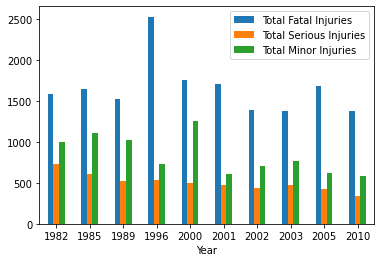

In [25]:
Year_group.sort_values(['Total Fatal Injuries'], ascending = False).head(10).sort_values(['Year']).plot.bar(rot=0, x='Year')

<AxesSubplot:xlabel='Country'>

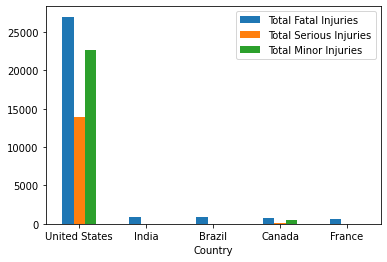

In [26]:
Country_group.sort_values(['Total Fatal Injuries'], ascending = False).head(5).plot.bar(rot=0, x='Country')

<AxesSubplot:xlabel='Year'>

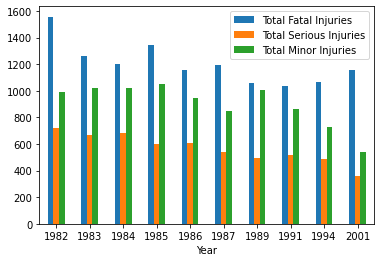

In [27]:
Country_Year_group[Country_Year_group['Country']=='United States'].sort_values(['Total Fatal Injuries'], ascending = False).head(10).sort_values(['Year']).plot.bar(rot=0, x='Year')

In [28]:
selected_countries = Country_group.sort_values(['Total Fatal Injuries'], ascending = False).head(10).Country

In [29]:
selected_countries_df = df[df['Country'].isin(selected_countries)].sort_values(['Total Fatal Injuries'], ascending = False).head(5000)

In [30]:
alt.Chart(selected_countries_df).mark_circle().encode(
    x='Year:O',
    y='Country',
    color='Country',
    size=alt.Size('Total Fatal Injuries:Q',
        scale=alt.Scale(range=[0, 2000]),
        legend=alt.Legend(title='Total Fatal Injuries')
    ) 
).properties(
    width=800,
    height=300
)

alt.Chart(...)

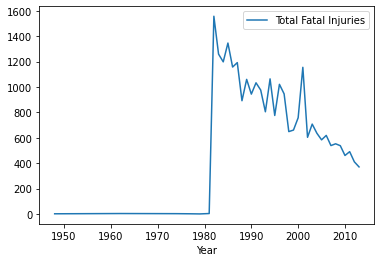

In [31]:
Country_Year_group[Country_Year_group['Country']=='United States'].plot(x="Year", y="Total Fatal Injuries", kind="line")
plt.show()

In [32]:
df= df[(df['Country']=='United States') & (df['Year']>1980)]
df.shape

(70668, 25)

In [33]:
Purpose_group = pd.DataFrame(df.groupby(['Purpose of Flight'])['Injury Severity'].value_counts())
Purpose_group.head(15)

Injury Severity
Purpose of Flight  Injury Severity                 
Aerial Application Non-Fatal                   3725
                   Fatal                        383
                   Incident                       3
Aerial Observation Non-Fatal                    412
                   Fatal                        128
                   Incident                       2
Air Drop           Non-Fatal                     19
                   Fatal                          5
Air Race/Show      Non-Fatal                     65
                   Fatal                         41
                   Incident                       1
Banner Tow         Non-Fatal                     58
                   Fatal                          8
Business           Non-Fatal                   2596
                   Fatal                        929

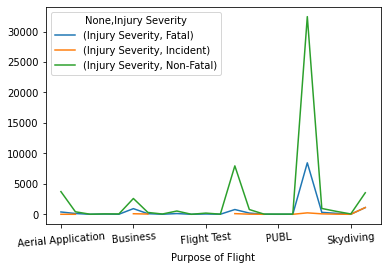

In [34]:
Purpose_group.unstack().plot()
plt.xticks(rotation=5)
plt.show()

## PCA 

it’s always advisable to account for correlation. It is a statistical term that measures the degree of linear dependency between variables. So variables that are highly correlated to each other are deemed to be non-contributors to a given predictive model. In fig below, I show the correlation plot for continuous variables. For instance, the variable aboard and fatalities have a strong negative correlation.

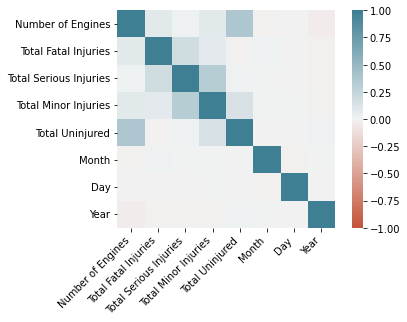

In [35]:
corr = df.corr()
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);

#### To treat correlation data I have applied PCA for continuos data and MCA for categorical data

In [36]:
df_numerical_cols = [col for col in df.columns if df[col].dtype != object]
df_numerical = df[df_numerical_cols]
df_numerical['Severity']=df['Injury Severity'].replace({"Fatal":0, "Incident":1, "Non-Fatal":2})
df_numerical.head(2)

,Number of Engines,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Month,Day,Year,Severity
0,2,3,0,0,0,12,8,2013,0
1,1,1,0,0,0,12,6,2013,0


In [37]:
df_st =  StandardScaler().fit_transform(df_numerical)
pd.DataFrame(df_st, columns=df_numerical.columns).head(2)

,Number of Engines,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Month,Day,Year,Severity
0,1.934560,1.075679,-0.249273,-0.236624,-0.174622,1.784305,-0.874168,1.929339,-2.046555
1,-0.271033,0.254043,-0.249273,-0.236624,-0.174622,1.784305,-1.100622,1.929339,-2.046555


#### Cumulative proportion of variance (from PC1 to PC3)   

In [38]:
pca_out = PCA(n_components=3).fit(df_st)
pca_out.explained_variance_ratio_

array([0.17380995, 0.14347475, 0.13885003])

In [39]:
loadings = pca_out.components_
num_pc = pca_out.n_features_
pc_list = ["PC"+str(i) for i in list(range(1, num_pc+1))]
loadings_df = pd.DataFrame.from_dict(dict(zip(pc_list, loadings)))
loadings_df

,PC1,PC2,PC3
0,0.470201,-0.342670,-0.387223
1,0.410882,0.556774,-0.093087
2,0.414791,0.147284,0.550866
3,0.421819,-0.150651,0.534263
4,0.412790,-0.519919,-0.254837
5,0.002095,0.084975,0.026950
6,-0.006895,-0.004869,0.005679
7,-0.044343,-0.026514,0.009023
8,-0.296125,-0.499928,0.432112


In [40]:
loadings_df['variable'] = df_numerical.columns.values
loadings_df = loadings_df.set_index('variable')
loadings_df

,PC1,PC2,PC3
variable,,,
Number of Engines,0.470201,-0.342670,-0.387223
Total Fatal Injuries,0.410882,0.556774,-0.093087
Total Serious Injuries,0.414791,0.147284,0.550866
Total Minor Injuries,0.421819,-0.150651,0.534263
Total Uninjured,0.412790,-0.519919,-0.254837
Month,0.002095,0.084975,0.026950
Day,-0.006895,-0.004869,0.005679
Year,-0.044343,-0.026514,0.009023
Severity,-0.296125,-0.499928,0.432112


In [41]:
# positive and negative values in component loadings reflects the positive and negative 
# correlation of the variables with the PCs.

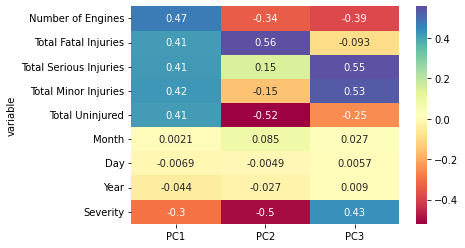

In [42]:
import seaborn as sns
import matplotlib.pyplot as plt
ax = sns.heatmap(loadings_df, annot=True, cmap='Spectral')
plt.show()

In [43]:
target = df['Injury Severity'].to_numpy()

In [44]:
pca_scores = PCA(n_components=3).fit_transform(df_st)

Now, we apply PCA the same dataset, and retrieve all the components. We use the same px.scatter_matrix trace to display our results, but this time our features are the resulting principal components, ordered by how much variance they are able to explain.

The importance of explained variance is demonstrated below. 

In [45]:
labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca_out.explained_variance_ratio_ * 100)
}

In [46]:
fig = px.scatter_matrix(
    pca_scores,
    labels=labels,
    dimensions=range(3),
    color=target
)
fig.update_traces(diagonal_visible=False)
fig.show()

### MCA

In [47]:
df[['Location_City','Location_State']] = df['Location'].str.split(',',expand=True)[[0,1]]
df[['Location','Location_City','Location_State']].head()

,Location,Location_City,Location_State
0,"Jacksonville, FL",Jacksonville,FL
1,"Sebring, FL",Sebring,FL
4,"Trenton, SC",Trenton,SC
5,"Dawsonville, GA",Dawsonville,GA
8,"Rock Lake, ND",Rock Lake,ND


In [48]:
df_categorical_cols = [col for col in df.columns if df[col].dtype == object]
df_categorical = df[df_categorical_cols]
df_categorical.head(2)

,Investigation Type,Event Date,Location,Country,Airport Code,Airport Name,Injury Severity,Aircraft Damage,Make,Model,Amateur Built,Engine Type,Purpose of Flight,Weather Condition,Broad Phase of Flight,Report Status,,Location_City,Location_State
0,Accident,12/08/2013,"Jacksonville, FL",United States,CRG,Jacksonville Executive Airport,Fatal,Substantial,CESSNA,310R,No,Reciprocating,Personal,IMC,NaN,Preliminary,,Jacksonville,FL
1,Accident,12/06/2013,"Sebring, FL",United States,SEF,Sebring Regional Airport,Fatal,Destroyed,TEXAS HELICOPTER CORP,M74L,No,Unknown,Positioning,NaN,NaN,Preliminary,,Sebring,FL


In [49]:
columns_drop = ['Country', 'Location']
df_categorical.drop(columns = columns_drop, inplace = True)


In [50]:
df_categorical.head()
mca_columns = ['Aircraft Damage','Weather Condition', 'Injury Severity', 'Engine Type']
df_mca = df[mca_columns]

In [51]:
print(df_mca.shape)
print(df_mca.isna().sum())

(70668, 4)
Aircraft Damage      1695
Weather Condition     254
Injury Severity         0
Engine Type           918
dtype: int64


In [52]:
df_mca.dropna(inplace=True)
print(df_mca.shape)

(68076, 4)


In [53]:
mca = prince.MCA()
mca = mca.fit(df_mca) 


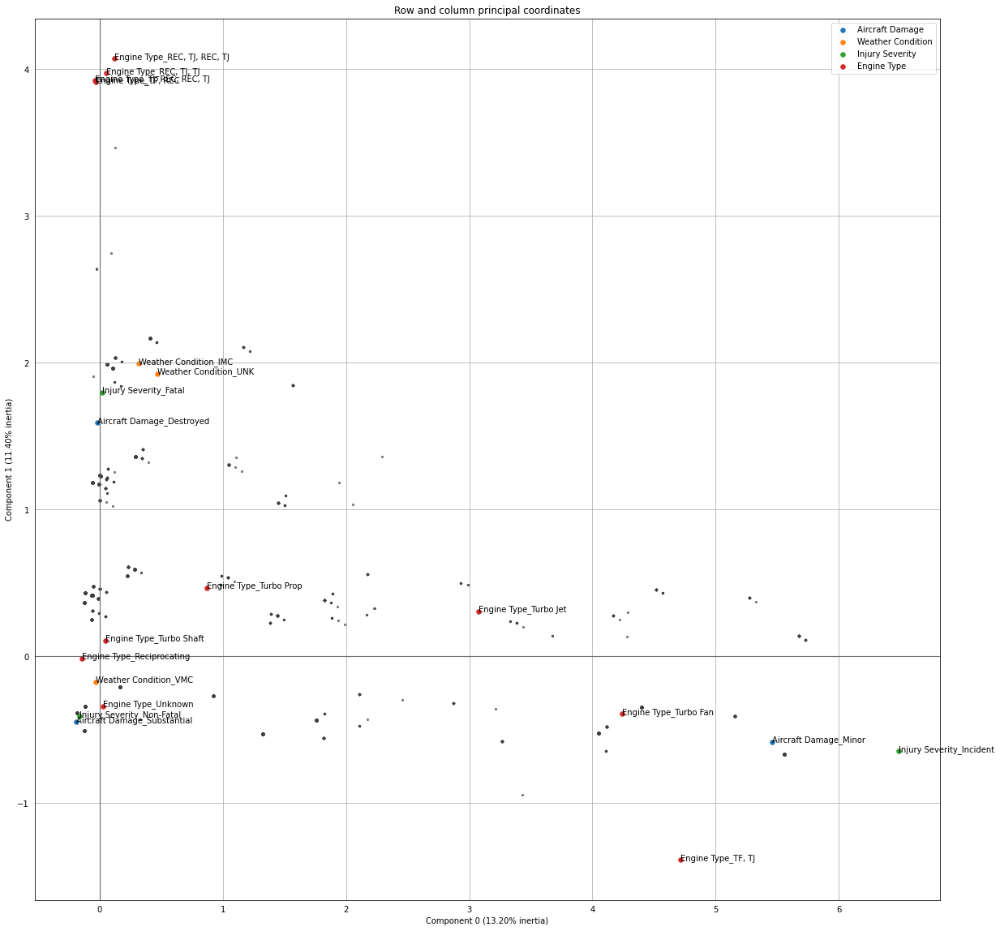

In [54]:
mca.plot_coordinates(df_mca,
                     figsize=(20, 20),
                     show_row_points=True,
                     row_points_size=5,
                     show_row_labels=False,
                     show_column_points=True,
                     column_points_size=30,
                     show_column_labels=True,
                     legend_n_cols=1
                                    );

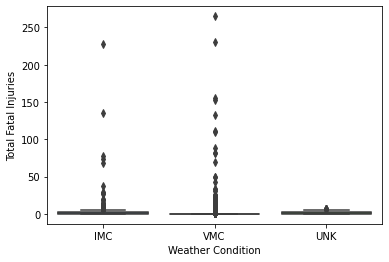

In [55]:
import seaborn as sns

sns.boxplot(data=df, x='Weather Condition', y='Total Fatal Injuries');

In [56]:
mca = mca.transform(df_mca)

In [57]:
mca

,0,1
0,0.000095,1.234011
5,0.407666,2.165111
9,0.058618,1.988176
10,0.060530,1.112833
11,-0.182318,-0.385291
...,...,...
74416,-0.063800,0.417384
74417,-0.063800,0.417384
74418,-0.182318,-0.385291
74419,-0.182318,-0.385291


### Applying Kmeans

In [58]:
st = pd.DataFrame(df_st, columns= df_numerical.columns)

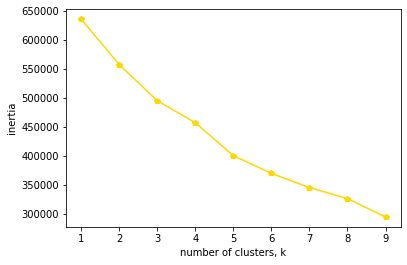

In [59]:
from sklearn.cluster import KMeans

# Obtain optimal number of clusters
inertias = []

# Creating 10 K-Mean models while varying the number of clusters (k)
for k in range(1,10):
    model = KMeans(n_clusters=k)
    
    # Fit model to samples
    model.fit(df_st)
    
    # Append the inertia to the list of inertias
    inertias.append(model.inertia_)
    
plt.plot(range(1,10), inertias, '-p', color='gold')
plt.xlabel('number of clusters, k')
plt.ylabel('inertia')
plt.show()

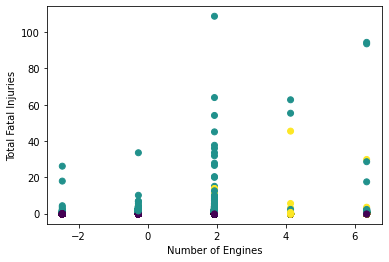

In [60]:
model = KMeans(n_clusters=3)
model.fit(df_st)

labels = model.predict(df_st)
plt.scatter(df_st[:,0], df_st[:,1], c=labels)
plt.xlabel("Number of Engines")
plt.ylabel("Total Fatal Injuries")
plt.show()

In [61]:
model.cluster_centers_

array([[-1.22916481e-01, -1.56759587e-01, -8.43691792e-03,
         1.28984036e-02, -1.06268159e-01, -7.22698918e-03,
         5.17786721e-04,  3.66143286e-03,  5.01608658e-01],
       [ 2.55031435e-01,  6.17674208e-01, -2.16200238e-02,
        -1.85659357e-01, -1.17930482e-01,  2.86217843e-02,
        -3.77900805e-04, -2.07038015e-02, -1.94942842e+00],
       [ 2.82066641e+00, -2.05558817e-02,  6.77663645e-01,
         1.66987584e+00,  6.62552454e+00, -2.74824413e-03,
        -2.04981564e-02,  7.81361072e-02, -2.68789314e-01]])

In [62]:
model.score(df_st)

-495714.85688358534

In [63]:
st['Cluster'] = labels
st['Severity'] = df_numerical.Severity.astype(int)

In [64]:
st.dropna(subset=['Severity'])

,Number of Engines,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Month,Day,Year,Severity,Cluster
0,1.934560,1.075679,-0.249273,-0.236624,-0.174622,1.784305,-0.874168,1.929339,0.0,1
1,-0.271033,0.254043,-0.249273,-0.236624,-0.174622,1.784305,-1.100622,1.929339,0.0,1
4,-0.271033,-0.156774,3.565556,-0.236624,-0.174622,1.455559,1.616821,1.929339,2.0,0
5,-0.271033,0.254043,-0.249273,-0.236624,-0.174622,1.455559,1.503594,1.929339,0.0,1
8,-0.271033,-0.156774,-0.249273,0.502883,-0.174622,1.455559,1.390367,1.929339,2.0,0
...,...,...,...,...,...,...,...,...,...,...
70662,-0.271033,-0.156774,-0.249273,-0.236624,-0.090015,-1.831904,-1.666756,-1.434407,2.0,0
70663,1.934560,-0.156774,-0.249273,-0.236624,-0.090015,-1.831904,-1.666756,-1.434407,0.0,0
70664,-0.271033,-0.156774,-0.249273,1.981896,-0.174622,-1.831904,-1.666756,-1.434407,0.0,0
70666,-0.271033,-0.156774,-0.249273,-0.236624,-0.132319,-1.831904,-1.666756,-1.434407,2.0,0
